# Optimized Kalman Filters Analysis

This notebook demonstrates the power of Kalman Filters with optimized parameters.
In other words, instead of determining $R$ and $Q$ by estimation from data, we determine them by direct optimization of MSE (along with the auxillary loss NLL) wrt $R,Q$, using gradient-descent (or more accurately, ADAM).

We define several scenarios and several variant of KF.
For each scenario and for each KF variant, we train the model on the training data of the scenario - once by estimating $R,Q$ and once by optimizing them. Then we test on the scenario's test data.
In other words, the parameters are determined in an offline manner, and once they are, the whole tracker is indistinguishable from any standard KF.

We demonstrate that:
1. **When using a "standard" KF, we actually have several non-trivial degrees of freedom** (e.g. KF vs. EKF, and coordinates of $R$) that sometimes have significant effect on the accuracy.
2. **Optimized KF achieves better MSE** than estimated KF for almost any scenario and any variant of KF.
3. Optimization is usually more beneficial when the variant of KF is poorly-chosen. Hence, **optimization makes the performance less sensitive to the chosen configuration of the KF**.
4. Optimized KF seems to usually do better when generalizing to different scenarios, though this result is not definite.

In addition, initial results indicate that both $R$ and $Q$ are important to optimize - optimization of either of them without the other results in somewhat reduced performance.

In [1]:
# Auto reload
%reload_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

import pickle as pkl
from collections import Counter
import gc

import torch
import torch.nn.functional as F

import utils
import TargetSimulator as Sim
import SensorGenerator as Rad
import Trackers
import NeuralTrackers as NT
import TrackingLab as TLAB
import PredictionLab as PLAB
import ScenarioSimulator as ssim

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
display(HTML("<style>.output_result { max-width:90% !important; }</style>"))
np.set_printoptions(precision=3)
np.set_printoptions(linewidth=150)
np.set_printoptions(suppress=True)
torch.set_printoptions(linewidth=150)

# Configurate scenarios & models

#### Scenarios

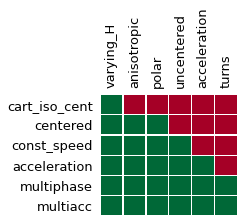

In [3]:
scenarios_meta_args = ssim.SCENARIOS_META_ARGS
ssim.show_meta_args_summary(scenarios_meta_args, utils.Axes(1,1,(3.5,3.2))[0],
                            cols=['varying_H', 'anisotropic', 'polar', 'uncentered', 'acceleration', 'turns']);
plt.tight_layout();

**Basic scenarios properties:**
- **varying_H**: the observation operator $H$ depends on target position.
- **anisotropic**: horizontal motion is more likely than vertical.
- **polar**: Radar detection noise is defined in polar coordinates (as in a real Radar system).
- **uncentered**: targets trajectories are not necessarily concentrated close to the location of the Radar.
- **acceleration**: target speed is not necessarily constant.
- **turns**: motion is not necessarily straight.

**Models** (estimated/optimized params; extended/standard KF; polar/cartesian representation of $R$):

In [4]:
models_args = (
    dict(load=False, title='KF', no_acc=True),
    dict(load=False, title='OKF', no_acc=True, const_Q=False, const_R=False),
    dict(load=False, title='KFp', no_acc=True, polar_R=True),
    dict(load=False, title='OKFp', no_acc=True, const_Q=False, const_R=False, polar_R=True),
    dict(load=False, title='EKF', no_acc=True, EKF=True),
    dict(load=False, title='OEKF', no_acc=True, const_Q=False, const_R=False, EKF=True),
    dict(load=False, title='EKFp', no_acc=True, EKF=True, polar_R=True),
    dict(load=False, title='OEKFp', no_acc=True, const_Q=False, const_R=False, polar_R=True, EKF=True),
)

model_names = [a['title'] for a in models_args]

gc.collect()

2415

# Generate scenarios


cart_iso_cent
['train', 'test']
Generating scenario train... done.	(15 [s])
Generating scenario test... done.	(5 [s])
1500 1500 (19, 4) (19, 6) 13.0 65.0 Counter({'00<acc<00': 1500})
{'max_acc': 0, 'time': 24.0}
   phase      mode  time  acc   direct  angle
0      0  straight    25  0.0  forward      0

centered
['train', 'test']
Generating scenario train... done.	(17 [s])
Generating scenario test... done.	(5 [s])
1500 1500 (19, 4) (19, 6) 13.0 65.0 Counter({'00<acc<00': 1500})
{'max_acc': 0, 'time': 24.0}
   phase      mode  time  acc   direct  angle
0      0  straight    25  0.0  forward      0

const_speed
['train', 'test']
Generating scenario train... done.	(14 [s])
Generating scenario test... done.	(4 [s])
1500 1500 (18, 4) (18, 6) 11.0 86.0 Counter({'00<acc<00': 1500})
{'max_acc': 0, 'time': 24.0}
   phase      mode  time  acc   direct  angle
0      0  straight    25  0.0  forward      0

acceleration
['train', 'test']
Generating scenario train... done.	(14 [s])
Generating scena

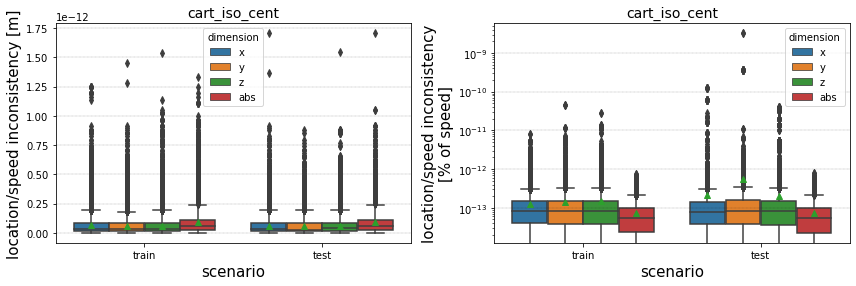

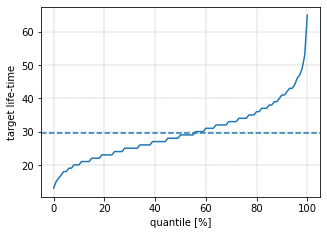

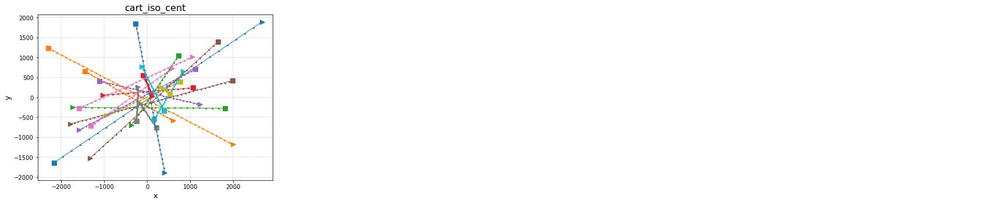

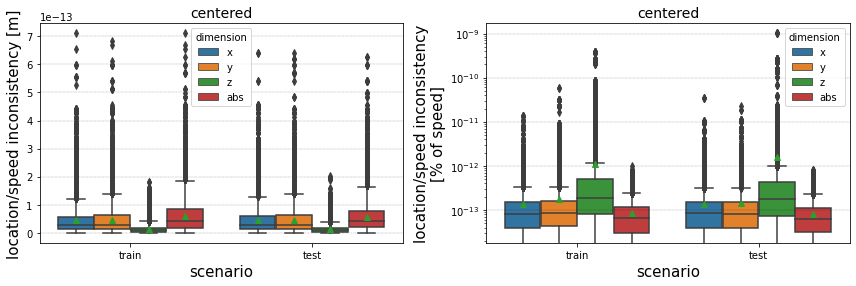

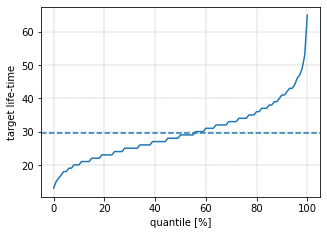

...

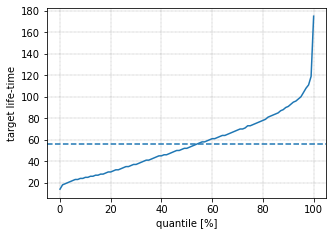

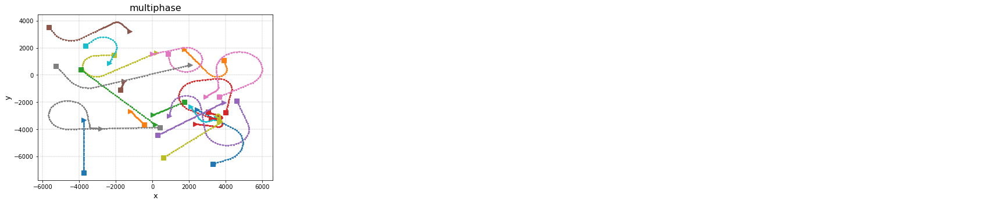

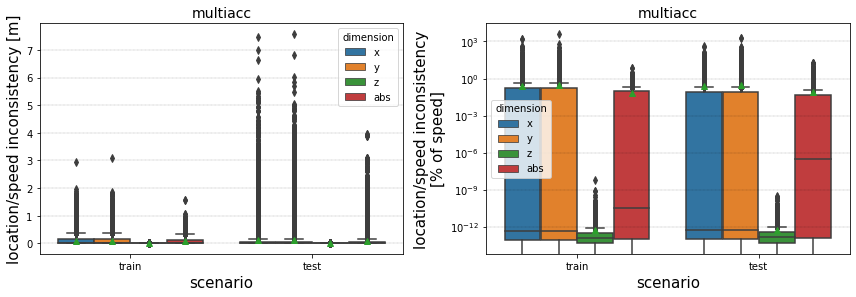

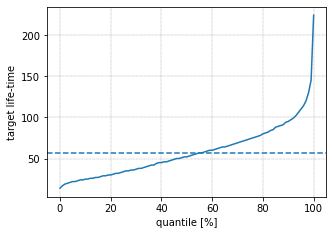

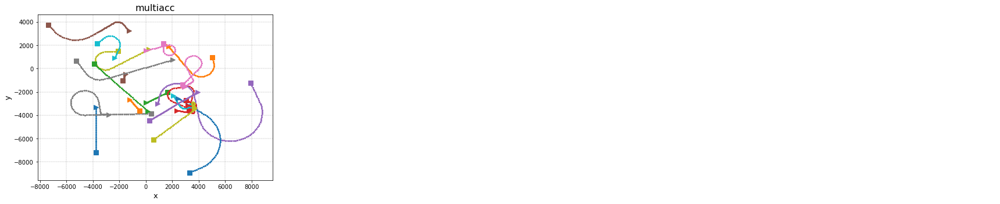

In [5]:
%time scenarios_args = ssim.generate_scenarios(meta_args=scenarios_meta_args)

#### Some properties of the scenarios

CPU times: user 5.43 s, sys: 176 ms, total: 5.6 s
Wall time: 5.4 s


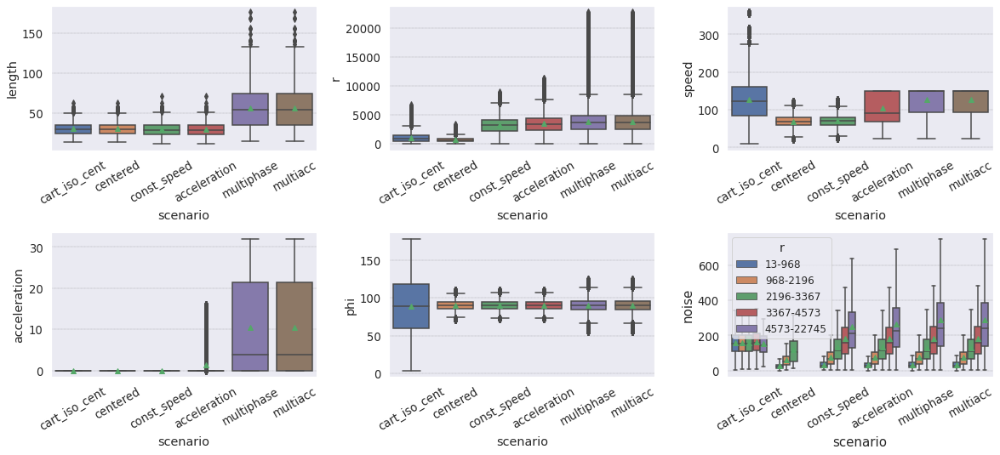

In [6]:
%time axs, dd, dd_tar = ssim.summarize_scenarios(list(scenarios_args.keys()))

# Train & test

For each scenario: for each model: train the model on the scenario's train data, then test it on the test data of the same scenario.

In [7]:
scenarios = list(scenarios_args.keys())


cart_iso_cent
Waiting for trainings...
Waiting for processes...
Done.	(189 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 88 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 128 (OKFp_s00)
	EKF: inf (EKF_s00)
	OEKF: 84 (OEKF_s00)
	EKFp: inf (EKFp_s00)
	OEKFp: 115 (OEKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered
Waiting for trainings...
Waiting for processes...
Done.	(197 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 27 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 25 (OKFp_s00)
	EKF: inf (EKF_s00)
	OEKF: 28 (OEKF_s00)
	EKFp: inf (EKFp_s00)
	OEKFp: 27 (OEKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed
Waiting for trainings...
Waiting for processes...
Done.	(185 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 95 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 94 (OKFp_s00)
	EKF: inf (EKF_s00)
	OEKF: 104 (OEKF_s00)
	EKFp: inf (EKFp_s00)
	OEKFp: 104 (OEKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(36 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration
Waiting for trainings...
Waiting for processes...
Done.	(228 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 104 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 103 (OKFp_s00)
	EKF: inf (EKF_s00)
	OEKF: 110 (OEKF_s00)
	EKFp: inf (EKFp_s00)
	OEKFp: 111 (OEKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase
Waiting for trainings...
Waiting for processes...
Done.	(338 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 121 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 121 (OKFp_s00)
	EKF: inf (EKF_s00)
	OEKF: 126 (OEKF_s00)
	EKFp: inf (EKFp_s00)
	OEKFp: 124 (OEKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(67 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiacc
Waiting for trainings...
Waiting for processes...
Done.	(380 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 117 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 120 (OKFp_s00)
	EKF: inf (EKF_s00)
	OEKF: 122 (OEKF_s00)
	EKFp: inf (EKFp_s00)
	OEKFp: 122 (OEKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(72 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])


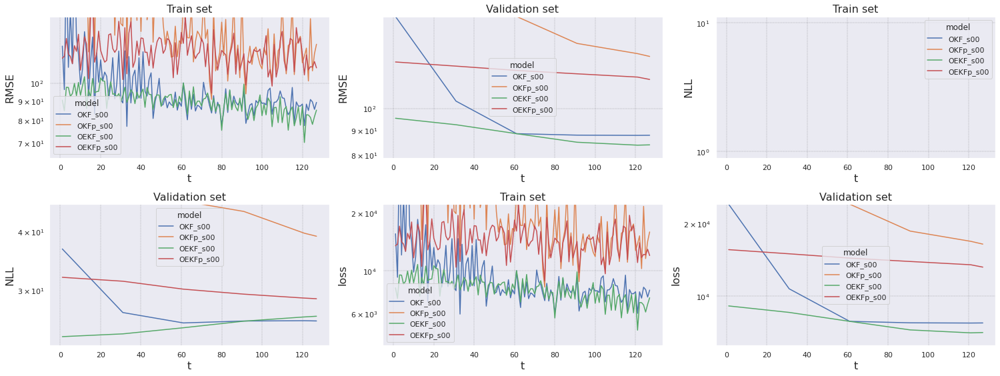

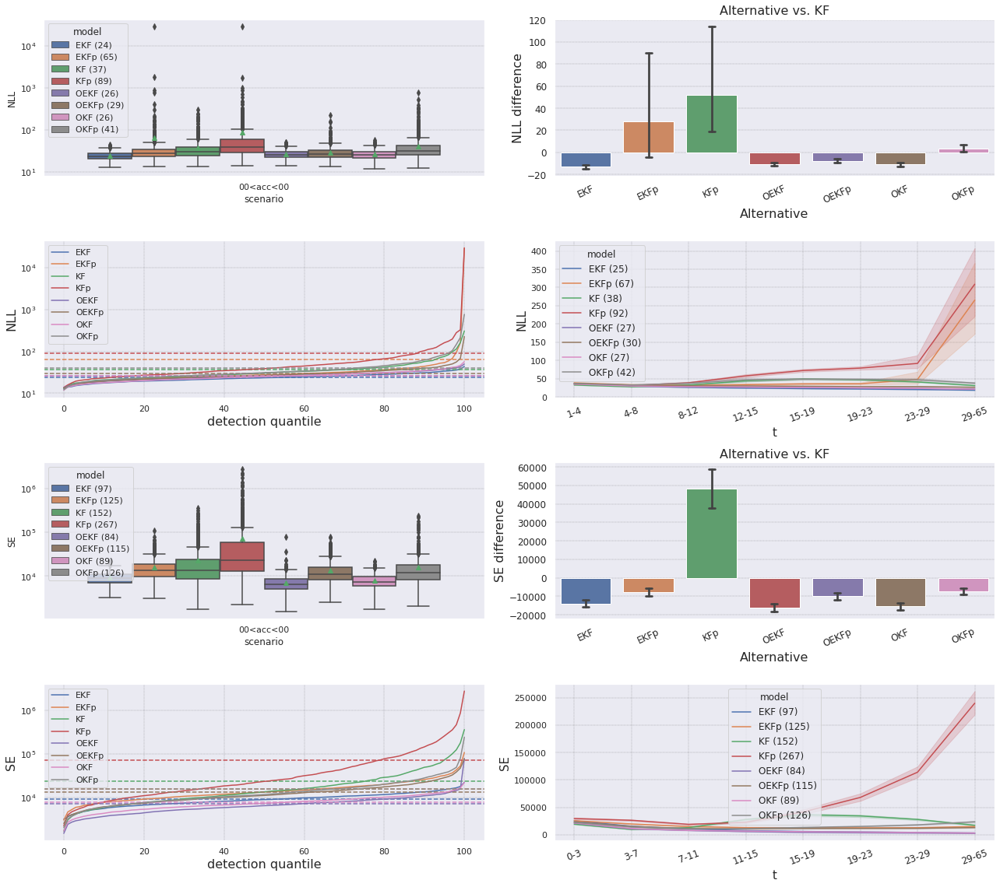

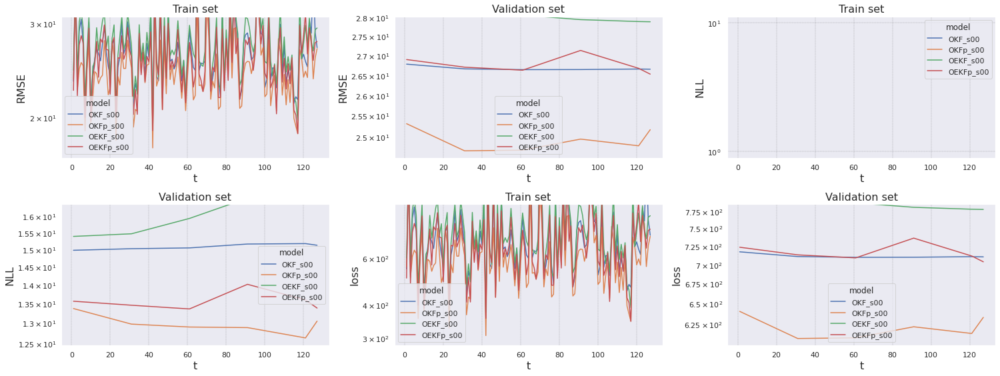

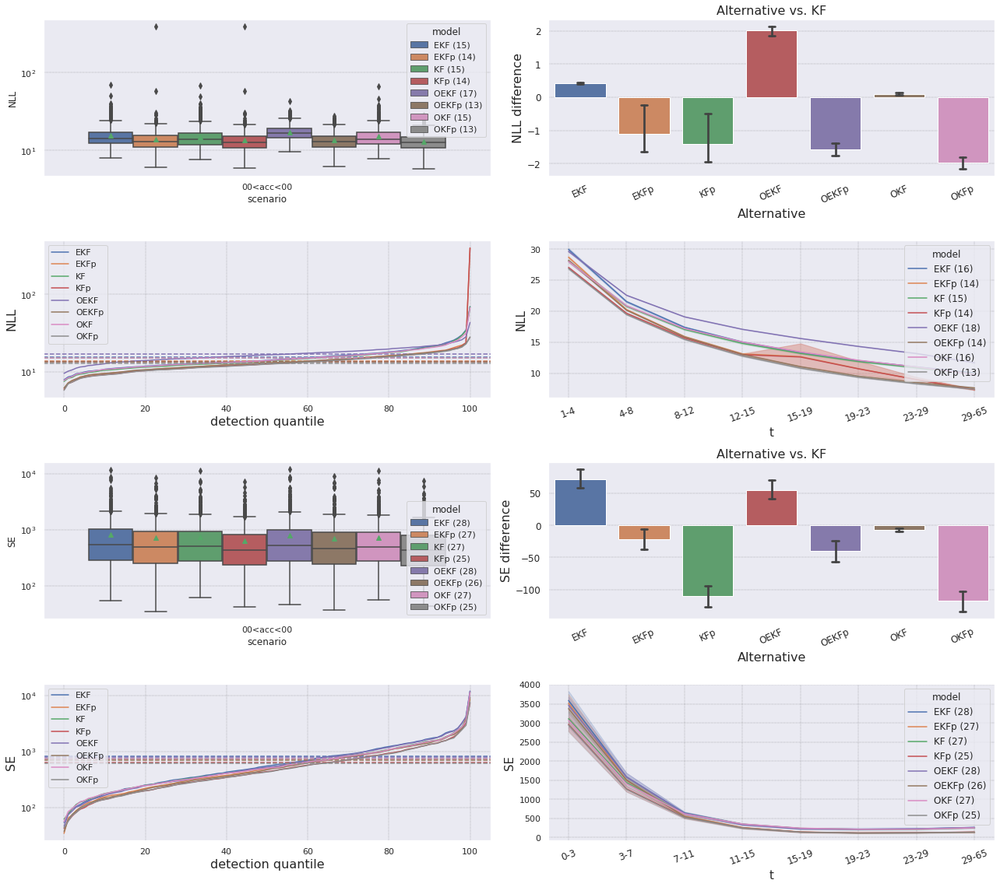

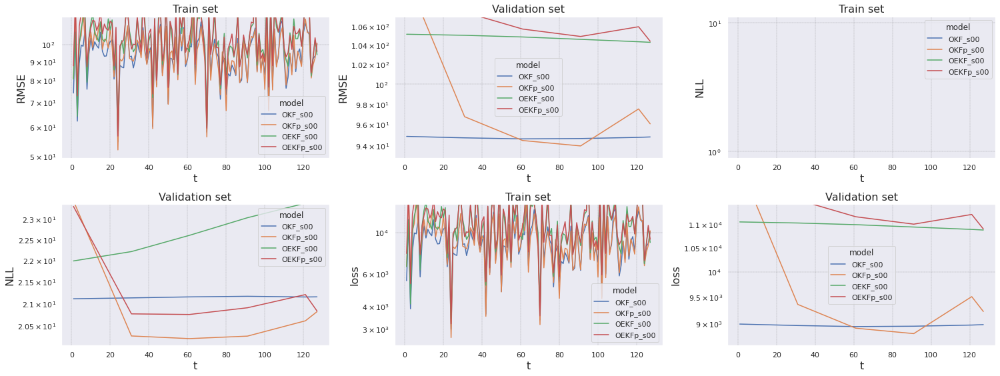

...

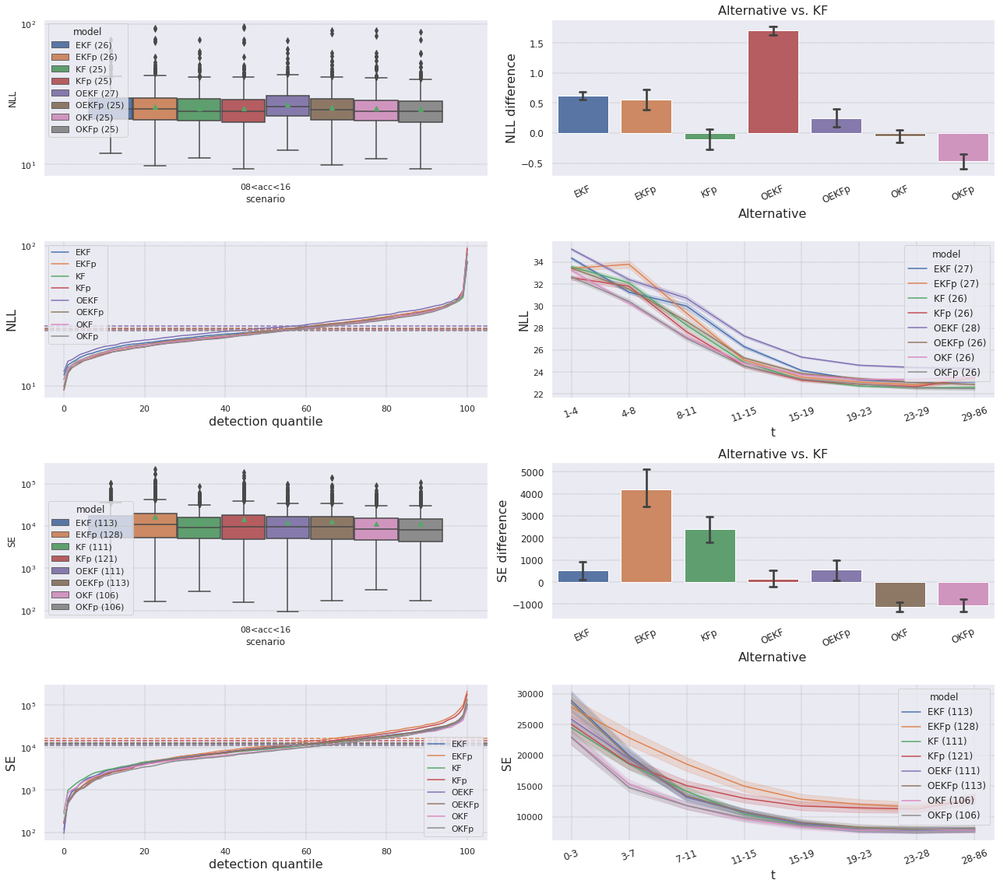

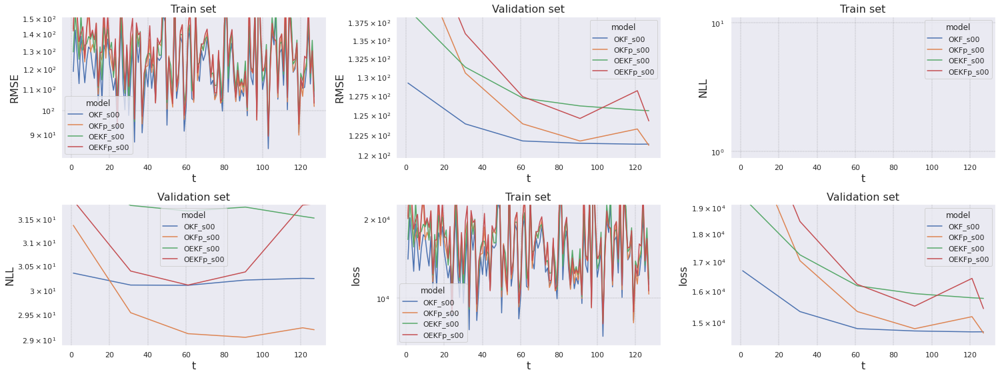

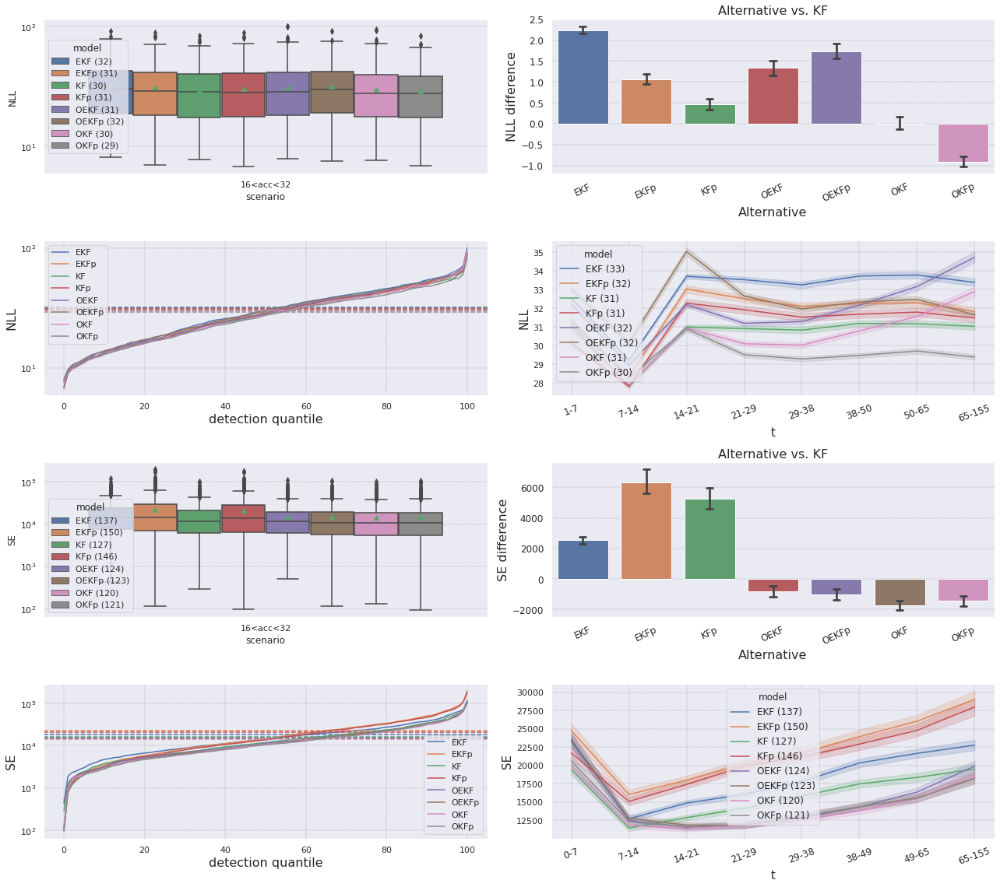

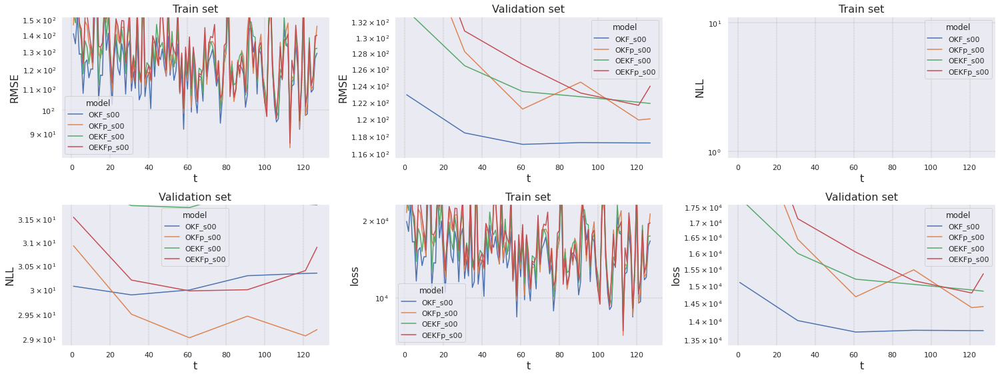

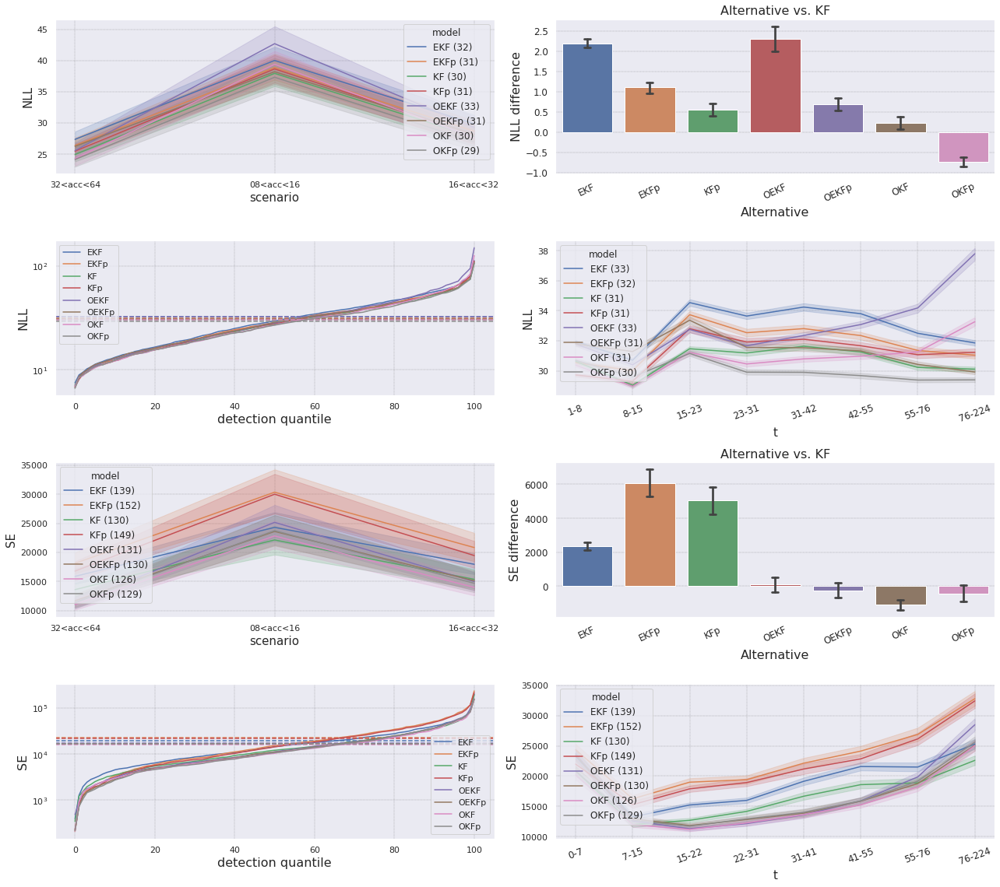

In [8]:
res = PLAB.multi_scenario_test(scenarios, models_args)

In [9]:
res

,model,scenario,target,t,predicted_gaussian,matched_gaussian,NLL,SE,AE,loss,tar_class
0,KF,cart_iso_cent,0,0,0,0,0.000000,3304.538466,57.485115,3304.538466,00<acc<00
1,KF,cart_iso_cent,0,1,0,0,35.673796,4592.003723,67.764325,4592.003723,00<acc<00
2,KF,cart_iso_cent,0,2,0,0,30.141762,18698.214642,136.741415,18698.214642,00<acc<00
3,KF,cart_iso_cent,0,3,0,0,29.399480,7499.555773,86.599976,7499.555773,00<acc<00
4,KF,cart_iso_cent,0,4,0,0,27.879694,1467.229642,38.304434,1467.229642,00<acc<00
...,...,...,...,...,...,...,...,...,...,...,...
477883,OEKFp,multiacc,990,70,0,0,24.663879,5124.348222,71.584553,5124.348222,32<acc<64
477884,OEKFp,multiacc,990,71,0,0,25.332903,822.520755,28.679623,822.520755,32<acc<64
477885,OEKFp,multiacc,990,72,0,0,22.424010,2152.526080,46.395324,2152.526080,32<acc<64
477886,OEKFp,multiacc,990,73,0,0,25.461598,1869.491644,43.237618,1869.491644,32<acc<64


Aggregate results per target:

In [10]:
res_tar = PLAB.res_per_target(res, ['model','scenario'])
res_tar

scenario  target model  wt         NLL  \
target model scenario                                                       
0      EKF   acceleration  0   acceleration       0   EKF  34   23.250820   
             cart_iso_cent 0  cart_iso_cent       0   EKF  33   19.424488   
             centered      0       centered       0   EKF  33   10.873330   
             const_speed   0    const_speed       0   EKF  34   16.404034   
             multiacc      0       multiacc       0   EKF  49   45.955672   
...                                     ...     ...   ...  ..         ...   
990    OKFp  cart_iso_cent 0  cart_iso_cent     990  OKFp  52  107.747040   
             centered      0       centered     990  OKFp  52   13.846196   
             const_speed   0    const_speed     990  OKFp  22   11.643203   
             multiacc      0       multiacc     990  OKFp  75   60.003643   
             multiphase    0     multiphase     990  OKFp  44   36.302347   

                                        SE          AE          loss  \
target model scenario                                                  
0      EKF   acceleration  0   2981.754699   47.781533   3486.766872   
             cart_iso_cent 0   7520.305000   69.232410   9060.484681   
             centered      0    310.171542   12.519526    373.695549   
             const_speed   0    714.894739   18.723843    835.974633   
             multiacc      0  14245.693257  109.749829  11558.924431   
...                                    ...         ...           ...   
990    OKFp  cart_iso_cent 0  61246.296266  244.527646  46828.085534   
             centered      0    849.567774   20.720955    649.567971   
             const_speed   0   7500.019190   55.678585  13554.066420   
             multiacc      0  16001.767193  138.505911   8482.748675   
             multiphase    0  10830.717829   99.493545   9786.659549   

                              tar_class  
target model scenario                    
0      EKF   acceleration  0  08<acc<16  
             cart_iso_cent 0  00<acc<00  
             centered      0  00<acc<00  
             const_speed   0  00<acc<00  
             multiacc      0  32<acc<64  
...                                 ...  
990    OKFp  cart_iso_cent 0  00<acc<00  
             centered      0  00<acc<00  
             const_speed   0  00<acc<00  
             multiacc      0  32<acc<64  
             multiphase    0  16<acc<32  

[47568 rows x 9 columns]

# Results analysis

#### Summary of results:

Estimated KFs:

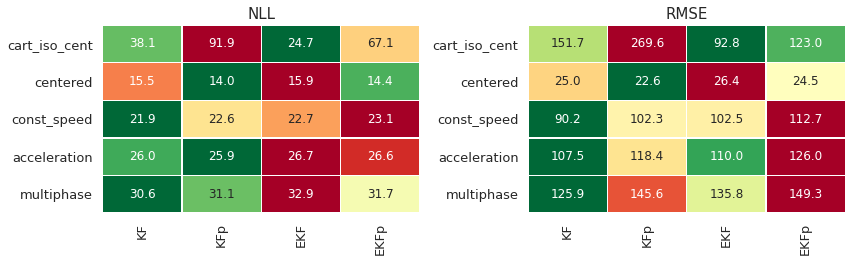

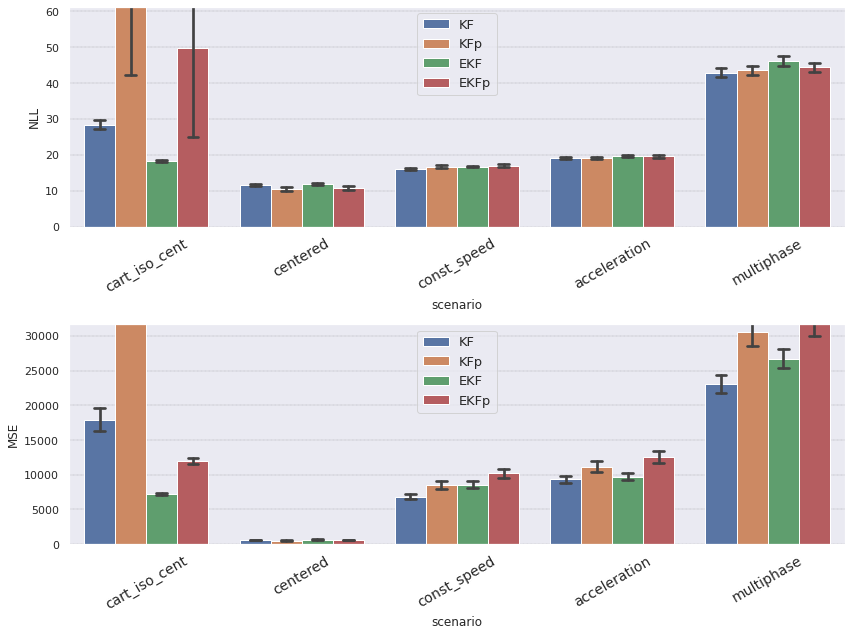

In [11]:
axs = PLAB.multi_scenario_analysis(res, res_tar, scenarios=scenarios[:-1], models=('KF','KFp','EKF','EKFp'));

Optimized KFs:

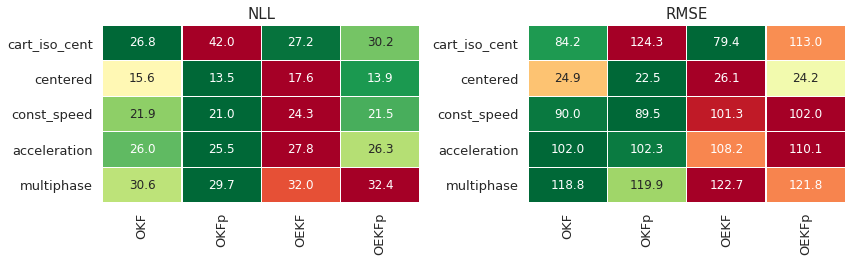

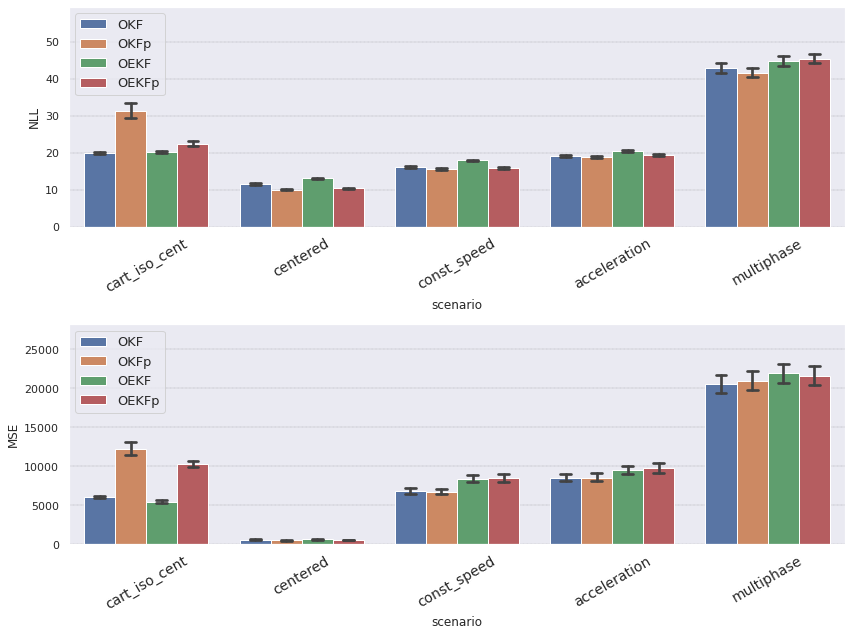

In [12]:
axs = PLAB.multi_scenario_analysis(res, res_tar, scenarios=scenarios[:-1], models=('OKF','OKFp','OEKF','OEKFp'));

All KFs:

CPU times: user 18.8 s, sys: 336 ms, total: 19.2 s
Wall time: 18.8 s


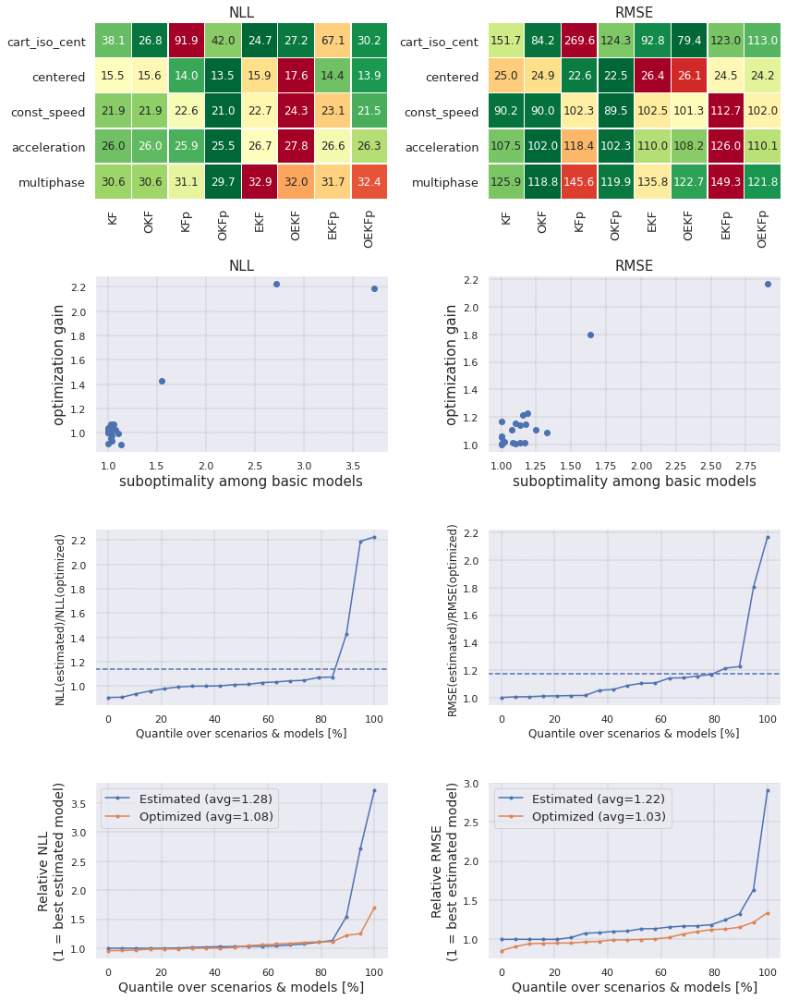

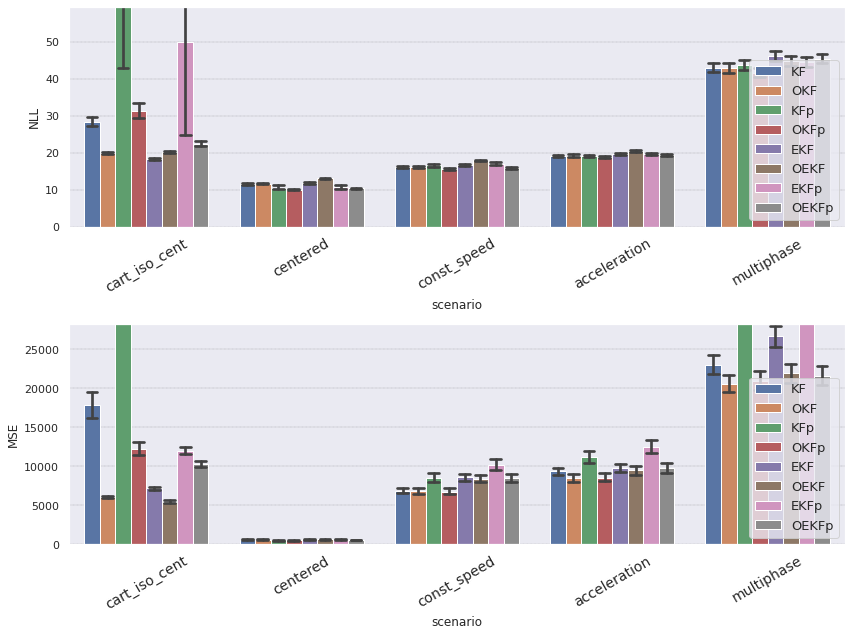

In [13]:
%time axs = PLAB.multi_scenario_analysis(res, res_tar, scenarios=scenarios[:-1], models=('KF','OKF','KFp','OKFp','EKF','OEKF','EKFp','OEKFp'));

#### KF vs. OKF on a sample of targets

XY plane:

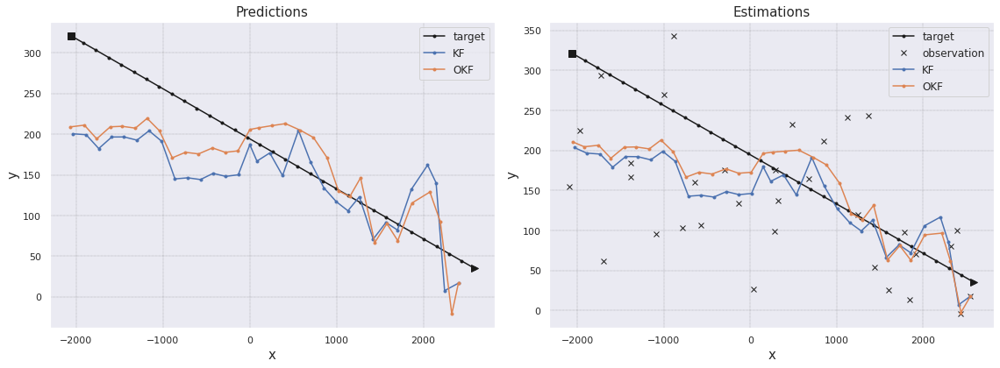

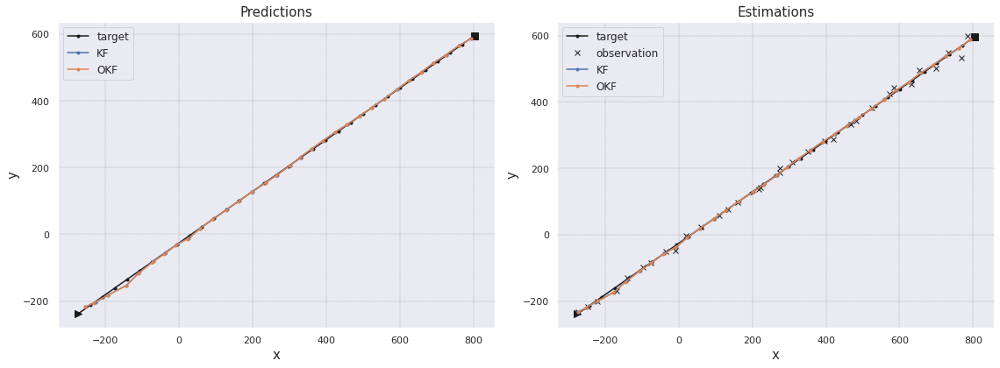

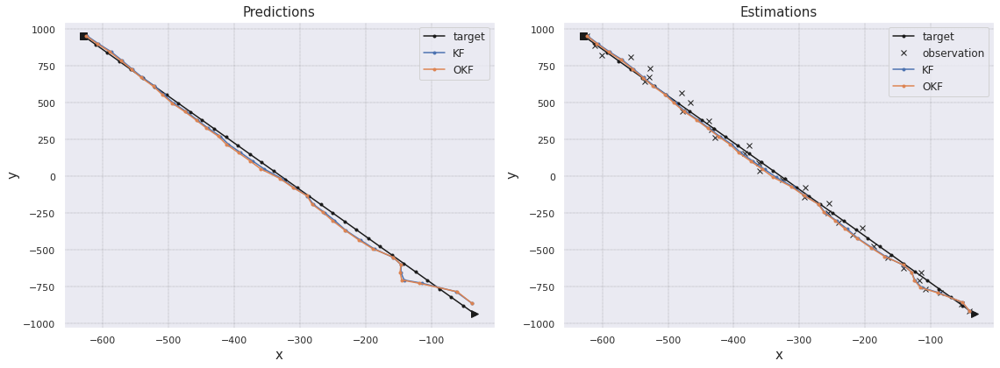

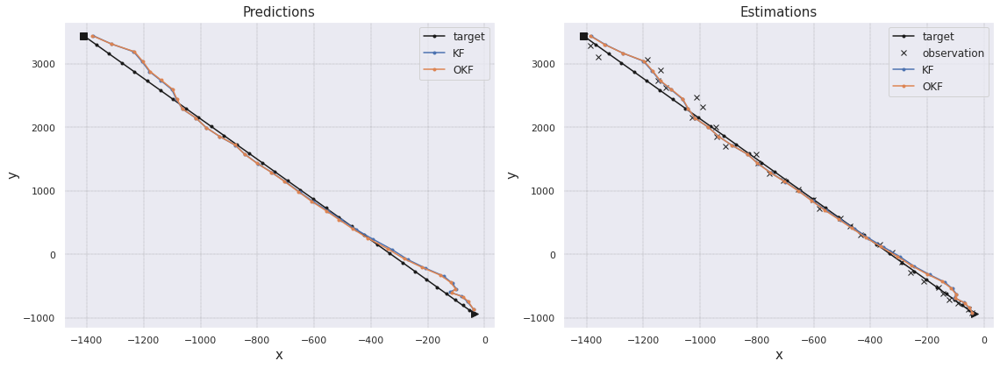

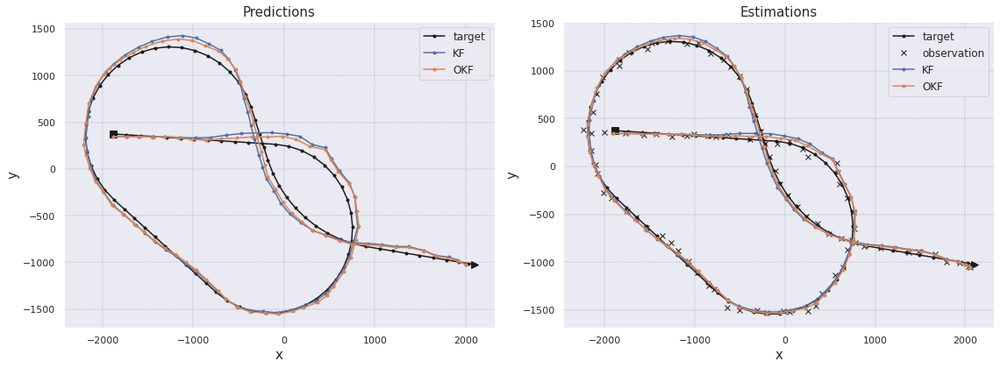

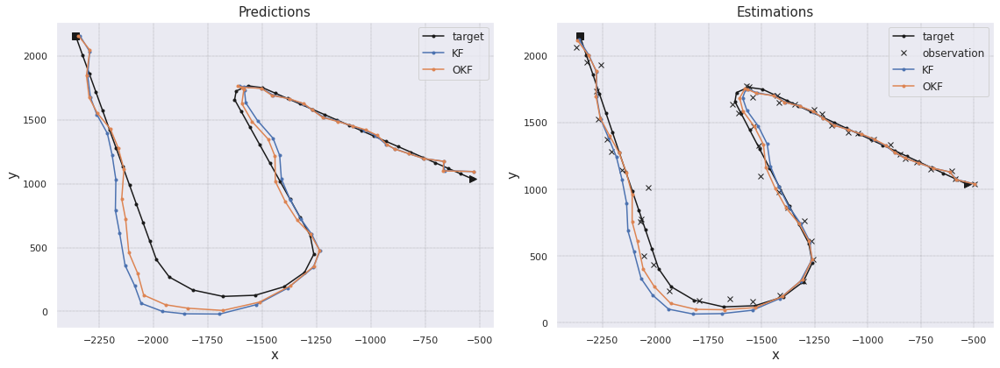

In [14]:
margs = [m for m in models_args if m['title'] in ('KF','OKF')]
axs = PLAB.multi_scenario_models_plot(scenarios, margs, 0);
# axs[-1][0].set_xlim((-2000,-1500))
# axs[-1][1].set_xlim((-2000,-1500))
# axs[-1][0].set_ylim((-2400,-1800))
# axs[-1][1].set_ylim((-2400,-1800))

XZ plane:

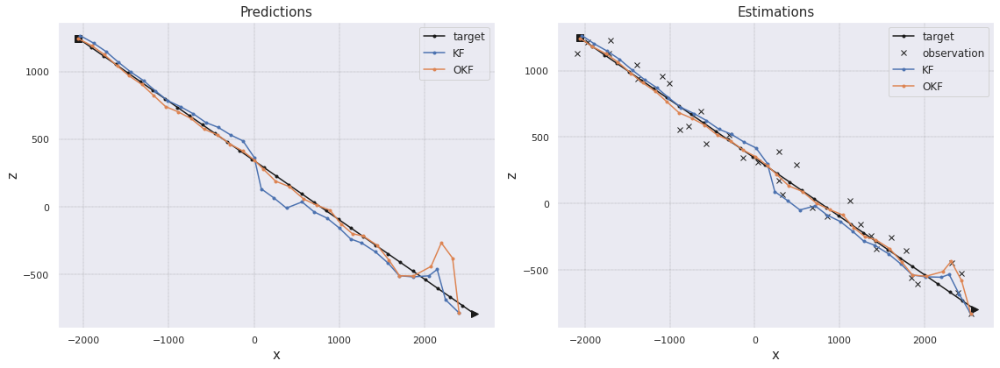

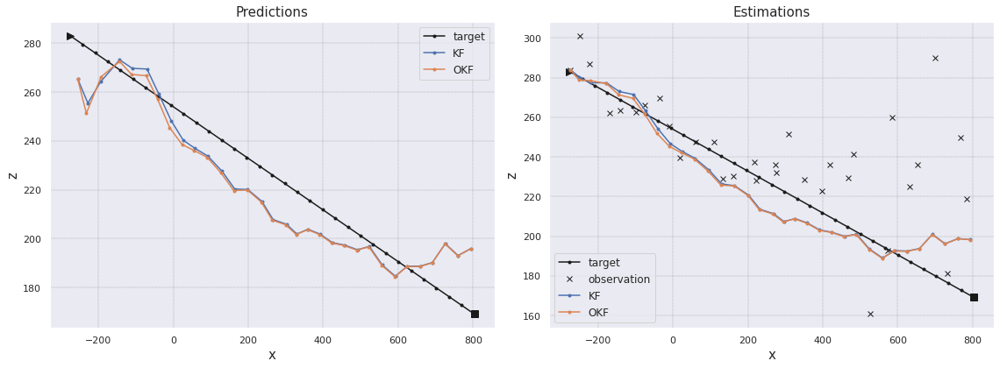

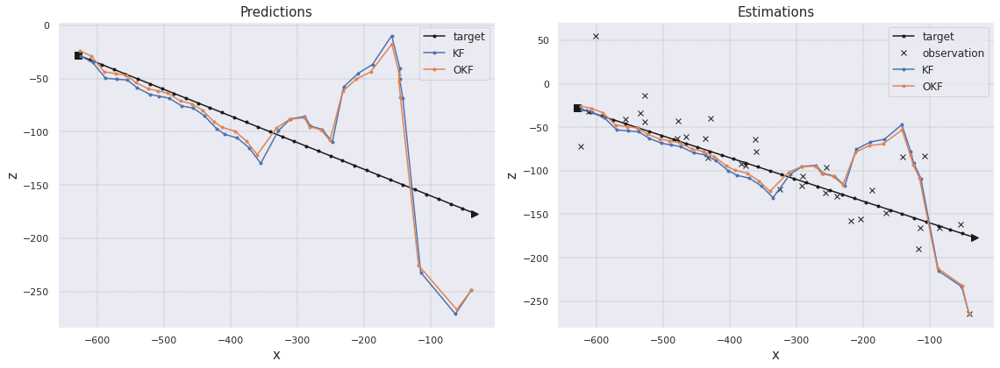

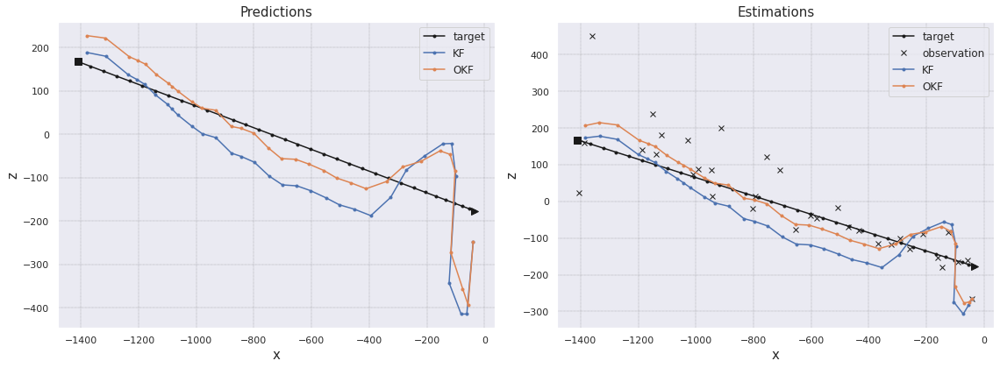

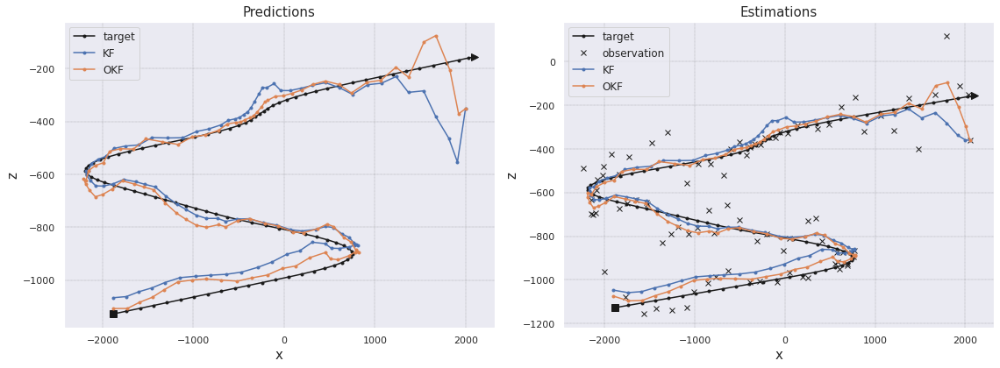

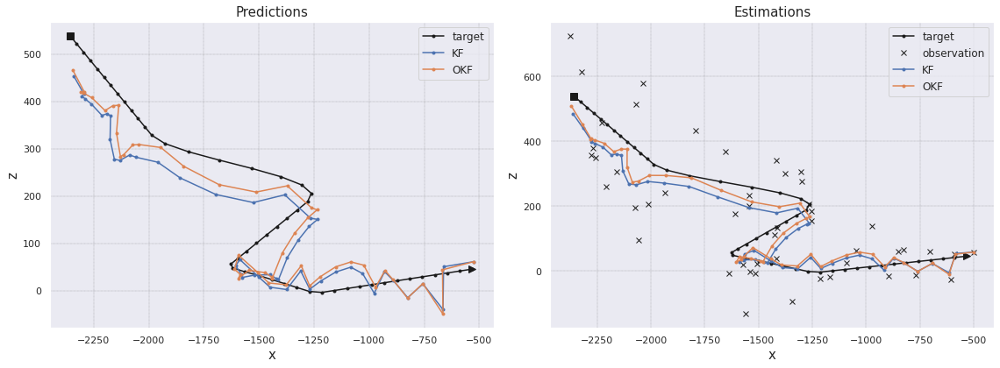

In [15]:
axs = PLAB.multi_scenario_models_plot(scenarios, margs, 0, dimy=2);

#### R & Q in KF vs. OKF

In R, OKF assigns less credit to the doppler signal (the variance of x,y,z is smaller).
Q is quite similar (OKF assigns slightly more credit to position over speed).

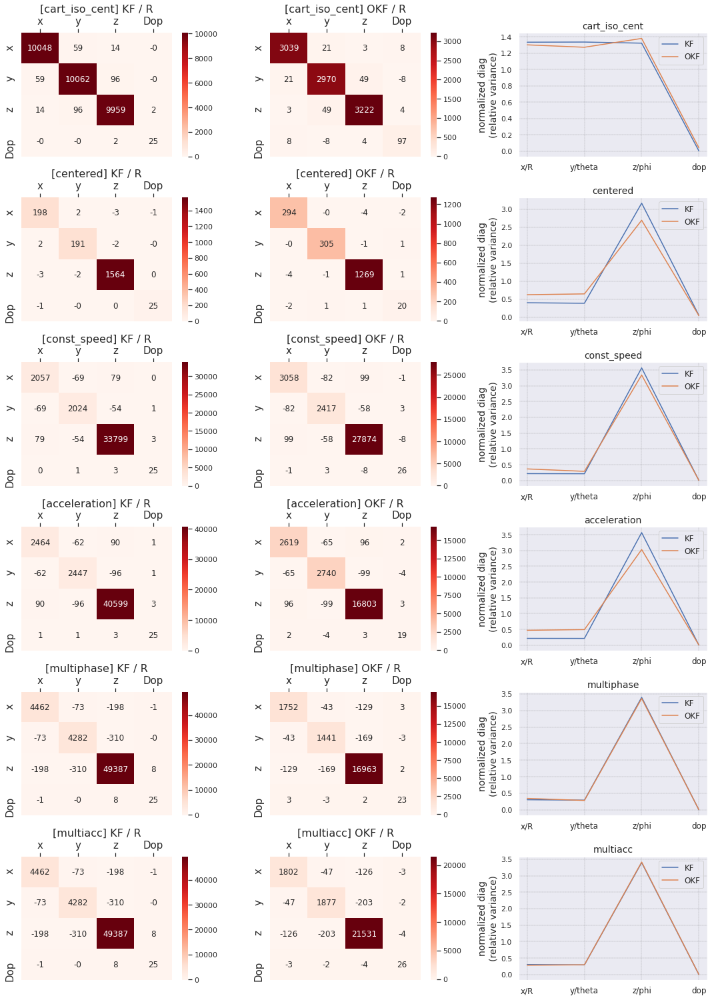

In [16]:
PLAB.compare_noise_models(scenarios, margs, noise='R');

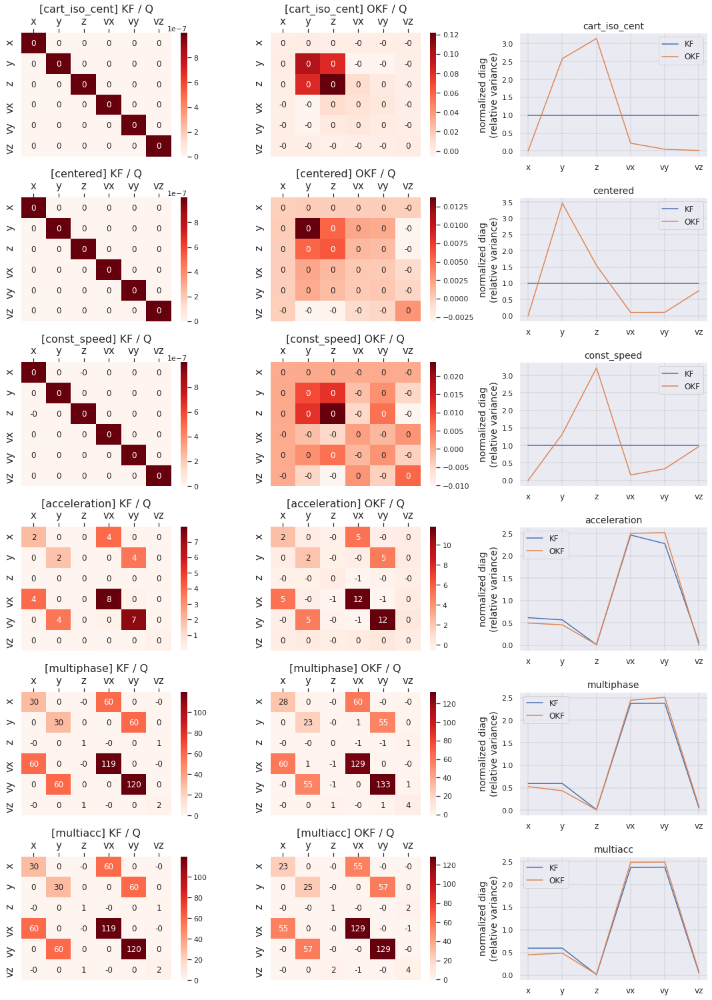

In [17]:
PLAB.compare_noise_models(scenarios, margs, noise='Q', log=False)

## Generalization wrt target acceleration

Generalization to different ranges of acceleration:

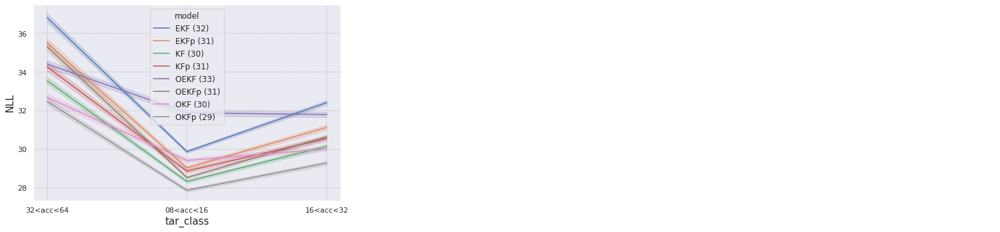

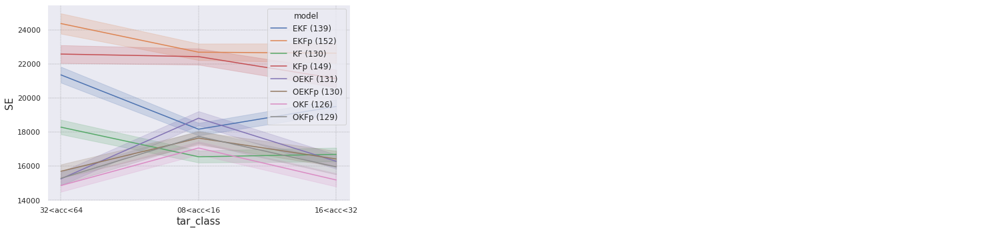

In [18]:
utils.compare_quantiles(res[res.scenario=='multiacc'], x='tar_class', y='NLL', hue='model');
utils.compare_quantiles(res[res.scenario=='multiacc'], x='tar_class', y='SE', hue='model', mean=lambda x:np.sqrt(np.mean(x)));

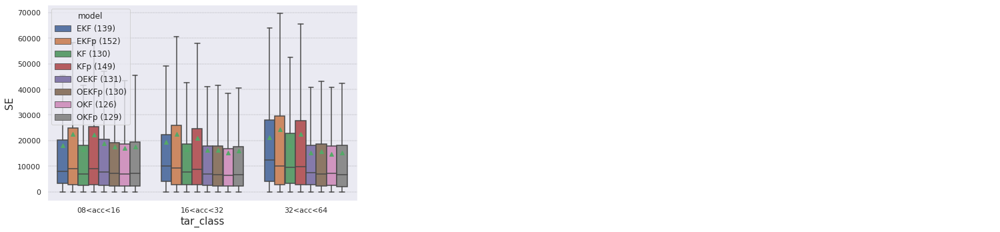

In [19]:
utils.compare_quantiles(res[res.scenario=='multiacc'], x='tar_class', y='SE', hue='model', box=True, showfliers=False,
                        order=('08<acc<16','16<acc<32','32<acc<64'), mean=lambda x:np.sqrt(np.mean(x)));

## Generalization across scenarios

For each pair `(i,j)` of scenarios: train on i's train data and test on j's test data.

The scenarios are roughly sorted by complexity, thus $i<j$ corresponds to "positive" generalization direction (generalizing to more complex scenario), and $i>j$ to "negative" direction (generalizing to simpler scenario).

In [20]:
%time gres, MSE, NLL = PLAB.test_across_scenarios(scenarios[:-1], models_args)

Running models trained on cart_iso_cent...
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(36 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(36 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(68 [s])
Running models trained on centered...
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(36 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(37 [s])
8 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(68 [s])
Running m

Loss (normalized s.t. best loss is 1) vs. model, per "generalization direction" (see definition above):

In [21]:
scenario_index = {s:i for i,s in enumerate(scenarios[:-1])}
gres['si'] = [scenario_index[s] for s in gres.train_scenario.values]
gres['sj'] = [scenario_index[s] for s in gres.test_scenario.values]
gres['generalization_dir'] = np.sign(gres.sj-gres.si)

In [22]:
gres

,model,train_scenario,test_scenario,MSE,NLL,MSE_best,NLL_best,MSE_rel,NLL_rel,si,sj,generalization_dir
0,KF,acceleration,acceleration,12264.442337,25.163226,11155.889612,24.693952,1.099369,1.019004,3,3,0
1,OKF,acceleration,acceleration,11155.889612,25.113139,11155.889612,24.693952,1.000000,1.016975,3,3,0
2,KFp,acceleration,acceleration,14649.062353,25.053068,11155.889612,24.693952,1.313124,1.014543,3,3,0
3,OKFp,acceleration,acceleration,11221.427835,24.693952,11155.889612,24.693952,1.005875,1.000000,3,3,0
4,EKF,acceleration,acceleration,12789.921797,25.788012,11155.889612,24.693952,1.146473,1.044305,3,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...
195,OKFp,multiphase,multiphase,14709.439733,29.187426,14445.383111,29.187426,1.018280,1.000000,4,4,0
196,EKF,multiphase,multiphase,18696.971171,32.336091,14445.383111,29.187426,1.294322,1.107877,4,4,0
197,OEKF,multiphase,multiphase,15368.203356,31.428717,14445.383111,29.187426,1.063883,1.076790,4,4,0
198,EKFp,multiphase,multiphase,22489.713211,31.159879,14445.383111,29.187426,1.556879,1.067579,4,4,0


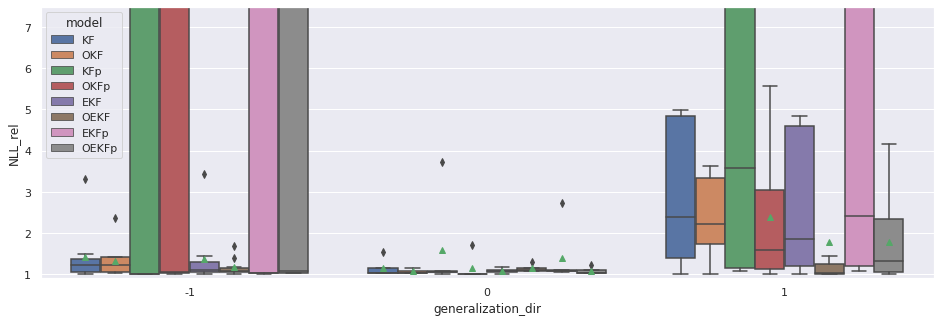

In [23]:
plt.figure(figsize=(16,5))
sns.boxplot(data=gres, y='NLL_rel', x='generalization_dir', hue='model', showmeans=True)
plt.ylim((0.9,7.5));

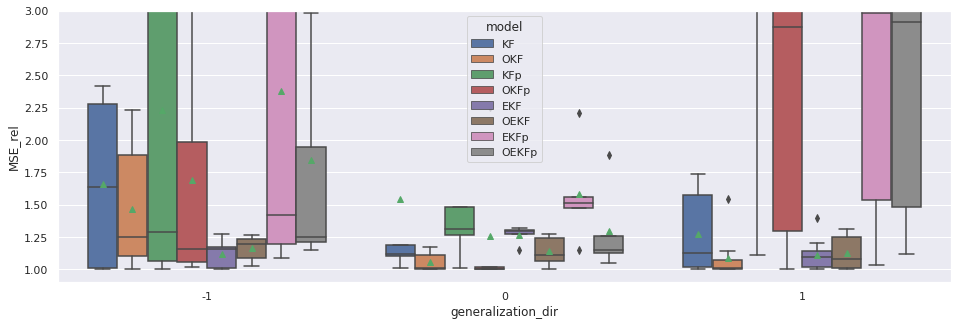

In [24]:
plt.figure(figsize=(16,5))
sns.boxplot(data=gres, y='MSE_rel', x='generalization_dir', hue='model', showmeans=True)
plt.ylim((0.9,3));

Optimized KF vs. Estimated KF per trained-scenario and tested-scenario (optimization is better $\Leftrightarrow$ value > 1):

In most cases it seems that optimization generalizes better than estimation - especially when generalizing to more complex scenarios (the cells above the diagonal in the figures). However, this phenomenon is not definite.

In [25]:
scenarios_labs = ['Toy', 'Close', 'Const_v', 'Const_a', 'Free']

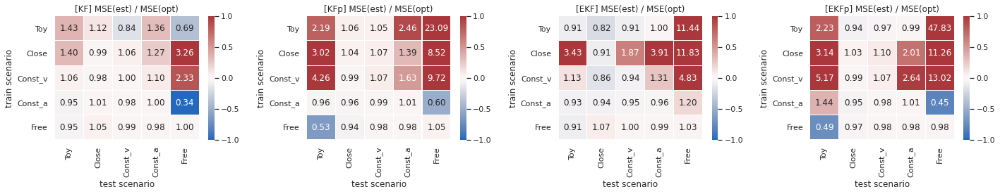

In [66]:
axs = utils.Axes(4,4,(5,4))
for m in range(4):
    ax = axs[m]
    mse_ratio = MSE[2*m,:,:]/MSE[2*m+1,:,:]
    sns.heatmap(np.log(mse_ratio), annot=mse_ratio, fmt='.2f', linewidths=0.1, ax=ax, cmap='vlag', vmin=-1, vmax=1)
    utils.labels(ax, 'test scenario', 'train scenario', f"[{models_args[2*m]['title']}] MSE(est) / MSE(opt)", 12)
    ax.set_xticklabels(scenarios_labs, rotation=90)
    ax.set_yticklabels(scenarios_labs, rotation=0)
plt.tight_layout()
plt.savefig('outputs/cross_scenarios_detailed.png', bbox_inches='tight')

MSE(est) / MSE(opt)

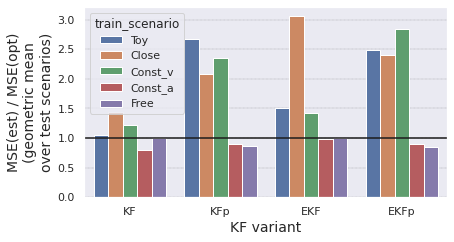

In [35]:
gsres = pd.DataFrame()
for m in range(4):
    mse_ratio = MSE[2*m,:,:]/MSE[2*m+1,:,:]
    mse_ratio = np.power(np.prod(mse_ratio, axis=1), 1/mse_ratio.shape[1])
    gsres = pd.concat((gsres, pd.DataFrame(dict(
        baseline = ['KF','KFp','EKF','EKFp'][m],
        train_scenario = scenarios_labs,
        mean_mse_ratio = mse_ratio,
    ))))

axs = utils.Axes(1,1, (6.5,3.5))
ax = axs[0]
ax.axhline(1, color='k')
sns.barplot(data=gsres, x='baseline', hue='train_scenario', y='mean_mse_ratio', ax=ax);
# ax.bar_label(ax.containers[-1], fmt='.2f'); #, label_type='center');
axs.labs(0, 'KF variant', 'MSE(est) / MSE(opt)\n(geometric mean\nover test scenarios)', fontsize=14)

MSE(opt) / MSE(est)

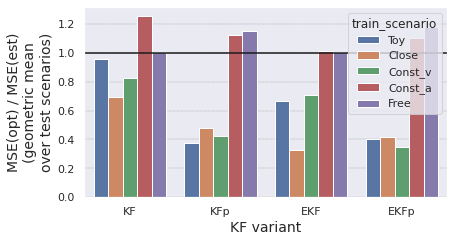

In [36]:
gsres = pd.DataFrame()
for m in range(4):
    mse_ratio = MSE[2*m+1,:,:]/MSE[2*m,:,:]
    mse_ratio = np.power(np.prod(mse_ratio, axis=1), 1/mse_ratio.shape[1])
    gsres = pd.concat((gsres, pd.DataFrame(dict(
        baseline = ['KF','KFp','EKF','EKFp'][m],
        train_scenario = scenarios_labs,
        mean_mse_ratio = mse_ratio,
    ))))

axs = utils.Axes(1,1, (6.5,3.5))
ax = axs[0]
ax.axhline(1, color='k')
sns.barplot(data=gsres, x='baseline', hue='train_scenario', y='mean_mse_ratio', ax=ax);
# ax.bar_label(ax.containers[-1], fmt='.2f'); #, label_type='center');
axs.labs(0, 'KF variant', 'MSE(opt) / MSE(est)\n(geometric mean\nover test scenarios)', fontsize=14)

log( MSE(est) / MSE(opt) )

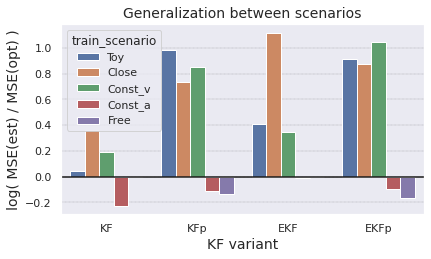

In [65]:
gsres = pd.DataFrame()
for m in range(4):
    mse_ratio = MSE[2*m,:,:]/MSE[2*m+1,:,:]
    mse_ratio = np.power(np.prod(mse_ratio, axis=1), 1/mse_ratio.shape[1])
    gsres = pd.concat((gsres, pd.DataFrame(dict(
        baseline = ['KF','KFp','EKF','EKFp'][m],
        train_scenario = scenarios_labs,
        mean_mse_ratio = mse_ratio,
        mean_log_mse_ratio = np.log(mse_ratio),
    ))))

axs = utils.Axes(1,1, (6.5,3.5))
ax = axs[0]
ax.axhline(0, color='k')
sns.barplot(data=gsres, x='baseline', hue='train_scenario', y='mean_log_mse_ratio', ax=ax);
# ax.bar_label(ax.containers[-1], fmt='.2f'); #, label_type='center');
axs.labs(0, 'KF variant', 'log( MSE(est) / MSE(opt) )', 'Generalization between scenarios', fontsize=14)
plt.savefig('outputs/cross_scenarios.png', bbox_inches='tight')

# The effect of train size

In [50]:
margs = [a for a in models_args if a['title'] in ('KF', 'OKF', 'KFp','OKFp')]
scs = scenarios[:-1]
n = len(PLAB.load_data(fname=f'{scs[-1]}_train')[0])
print('Total train data size:', n)

Total train data size: 1500



cart_iso_cent_n0020
Waiting for trainings...
Waiting for processes...
Done.	(74 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 88 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 156 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(20 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n0020
Waiting for trainings...
Waiting for processes...
Done.	(89 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 17 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 14 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n0020
Waiting for trainings...
Waiting for processes...
Done.	(71 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 102 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 126 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n0020
Waiting for trainings...
Waiting for processes...
Done.	(73 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 138 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 169 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n0020
Waiting for trainings...
Waiting for processes...
Done.	(112 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 78 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 71 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(35 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



cart_iso_cent_n0030
Waiting for trainings...
Waiting for processes...
Done.	(101 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 94 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 111 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n0030
Waiting for trainings...
Waiting for processes...
Done.	(93 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 18 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 18 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n0030
Waiting for trainings...
Waiting for processes...
Done.	(95 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 111 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 136 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(18 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n0030
Waiting for trainings...
Waiting for processes...
Done.	(103 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 151 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 178 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n0030
Waiting for trainings...
Waiting for processes...
Done.	(154 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 132 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 132 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(33 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



cart_iso_cent_n0050
Waiting for trainings...
Waiting for processes...
Done.	(99 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 86 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 119 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/utils.py:78: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  self.axs = plt.subplots(self.H, self.W, figsize=(self.W*axsize[0], self.H*axsize[1]))[1]
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n0050
Waiting for trainings...
Waiting for processes...
Done.	(112 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 41 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 35 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(20 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n0050
Waiting for trainings...
Waiting for processes...
Done.	(106 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 99 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 113 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(18 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n0050
Waiting for trainings...
Waiting for processes...
Done.	(99 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 142 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 151 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n0050
Waiting for trainings...
Waiting for processes...
Done.	(250 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 86 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 81 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(34 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



cart_iso_cent_n0100
Waiting for trainings...
Waiting for processes...
Done.	(118 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 95 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 114 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n0100
Waiting for trainings...
Waiting for processes...
Done.	(112 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 30 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 27 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(20 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n0100
Waiting for trainings...
Waiting for processes...
Done.	(130 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 96 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 97 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n0100
Waiting for trainings...
Waiting for processes...
Done.	(118 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 103 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 100 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n0100
Waiting for trainings...
Waiting for processes...
Done.	(202 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 116 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 115 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(34 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



cart_iso_cent_n0300
Waiting for trainings...
Waiting for processes...
Done.	(130 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 94 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 121 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(18 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n0300
Waiting for trainings...
Waiting for processes...
Done.	(137 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 31 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 29 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(18 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n0300
Waiting for trainings...
Waiting for processes...
Done.	(130 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 90 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 90 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n0300
Waiting for trainings...
Waiting for processes...
Done.	(125 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 100 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 98 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n0300
Waiting for trainings...
Waiting for processes...
Done.	(226 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 122 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 122 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(33 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



cart_iso_cent_n1000
Waiting for trainings...
Waiting for processes...
Done.	(194 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 87 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 113 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n1000
Waiting for trainings...
Waiting for processes...
Done.	(199 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 28 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 25 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n1000
Waiting for trainings...
Waiting for processes...
Done.	(204 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 97 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 96 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n1000
Waiting for trainings...
Waiting for processes...
Done.	(225 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 107 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 106 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n1000
Waiting for trainings...
Waiting for processes...
Done.	(352 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 126 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 124 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(34 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



cart_iso_cent_n1500
Waiting for trainings...
Waiting for processes...
Done.	(332 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 88 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 120 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



centered_n1500
Waiting for trainings...
Waiting for processes...
Done.	(311 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 27 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 25 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



const_speed_n1500
Waiting for trainings...
Waiting for processes...
Done.	(355 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 95 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 94 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(19 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



acceleration_n1500
Waiting for trainings...
Waiting for processes...
Done.	(361 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 103 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 102 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(18 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])



multiphase_n1500
Waiting for trainings...
Waiting for processes...
Done.	(610 [s])
Best validation losses:
	KF: inf (KF_s00)
	OKF: 121 (OKF_s00)
	KFp: inf (KFp_s00)
	OKFp: 119 (OKFp_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(33 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])


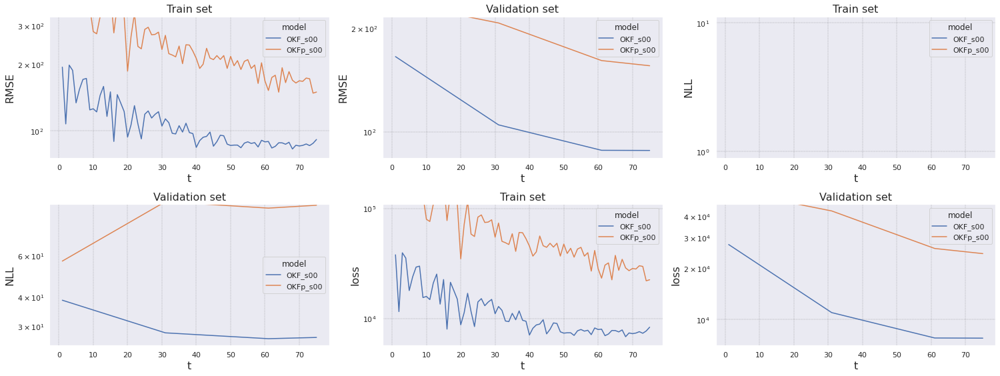

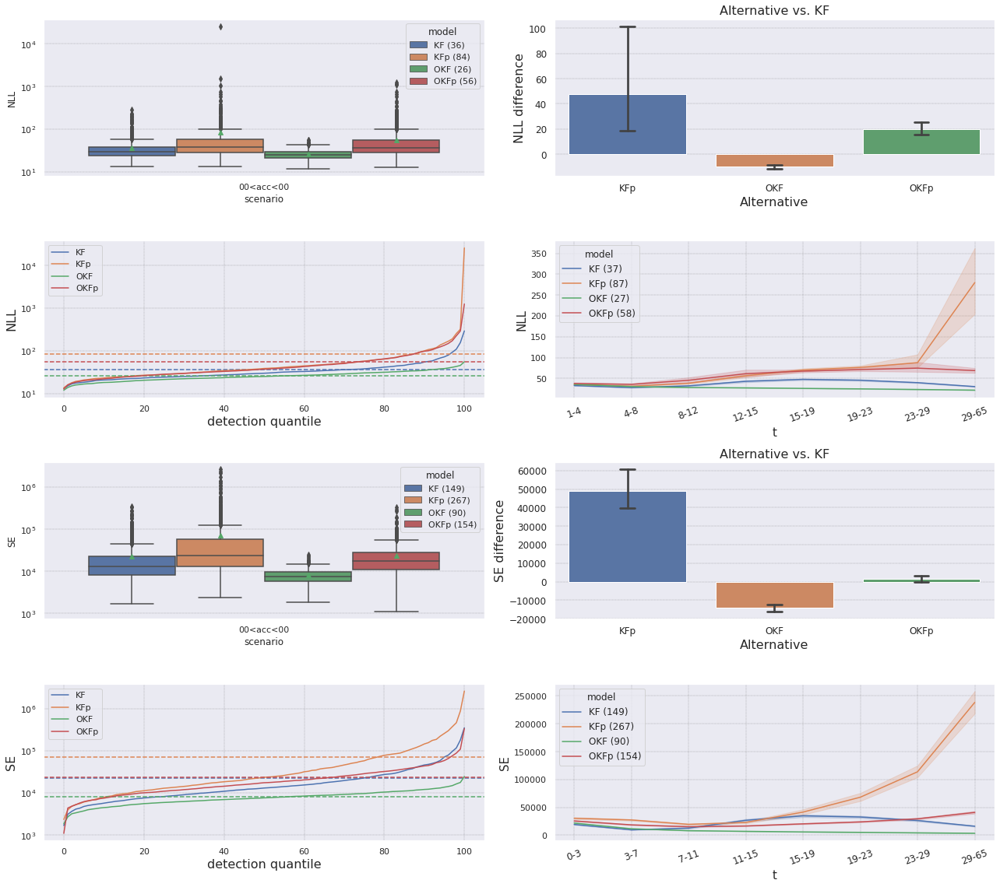

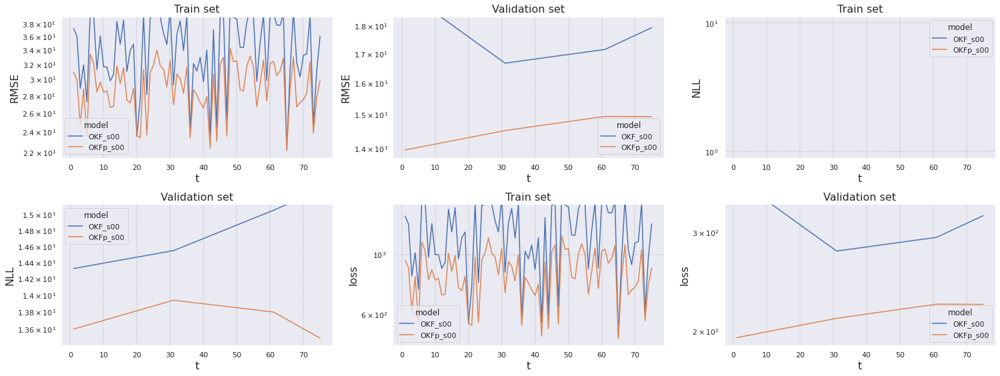

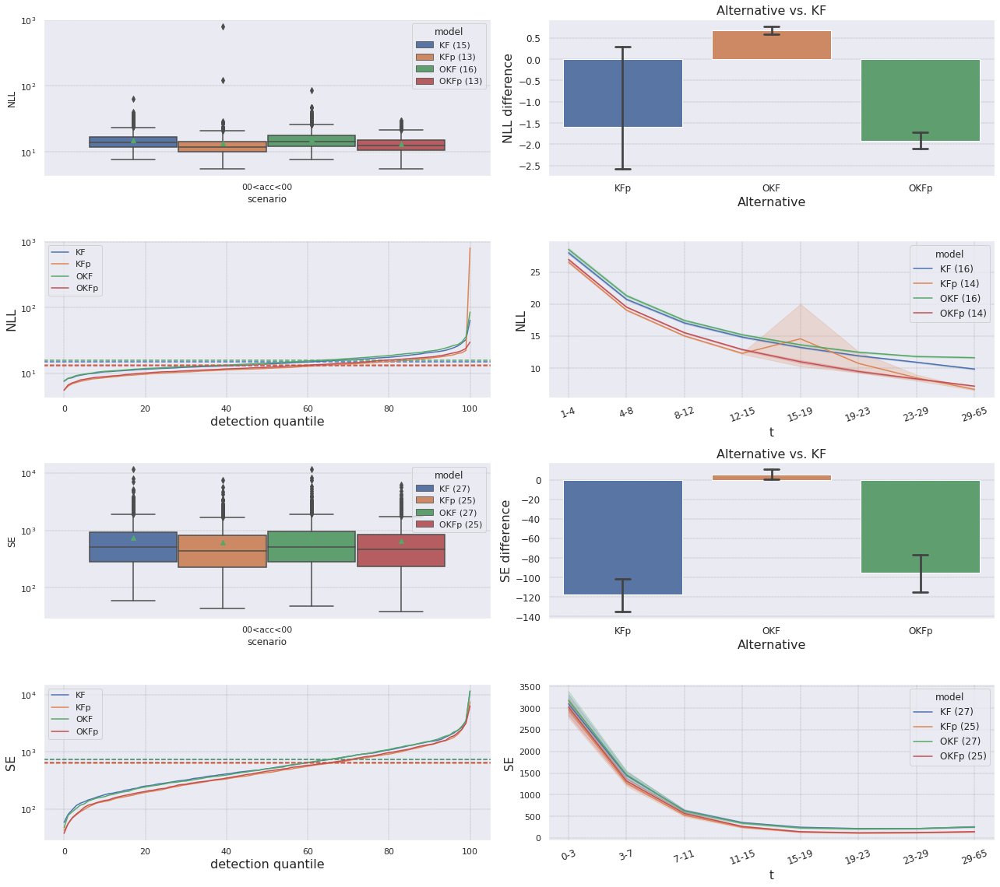

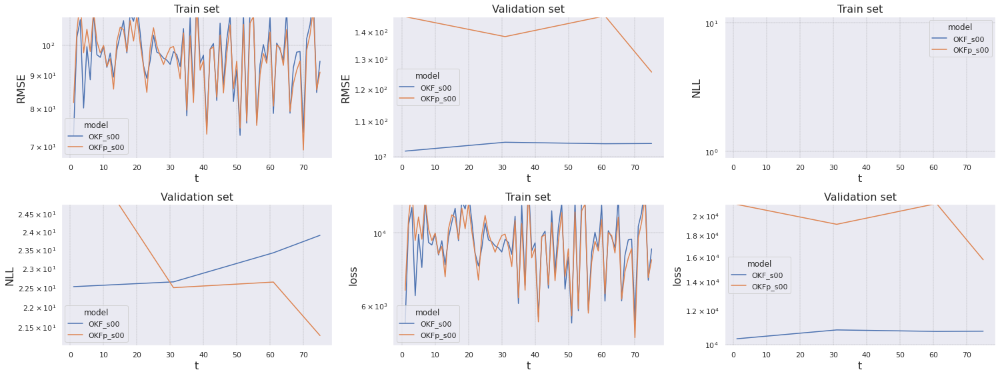

...

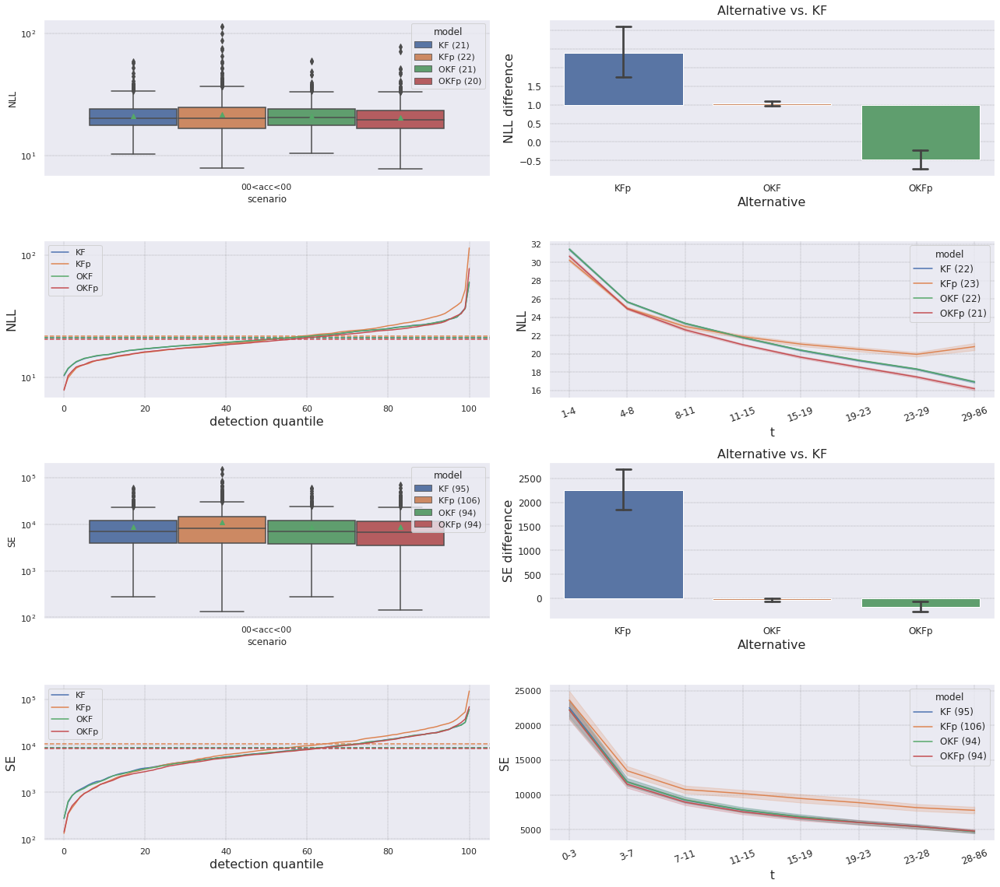

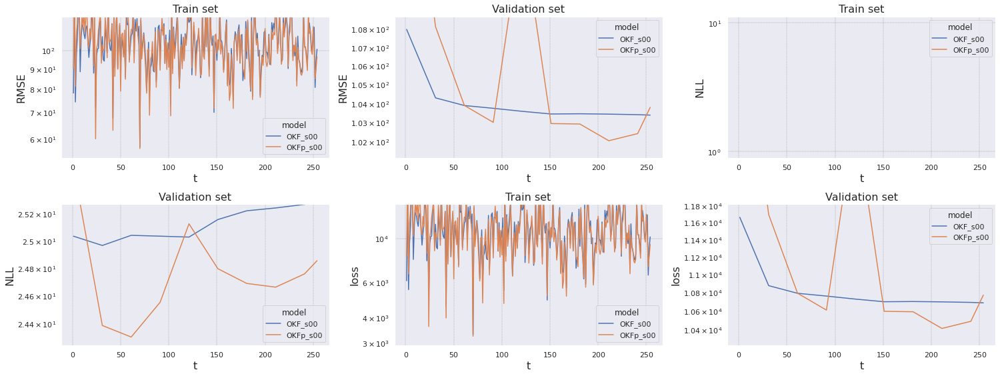

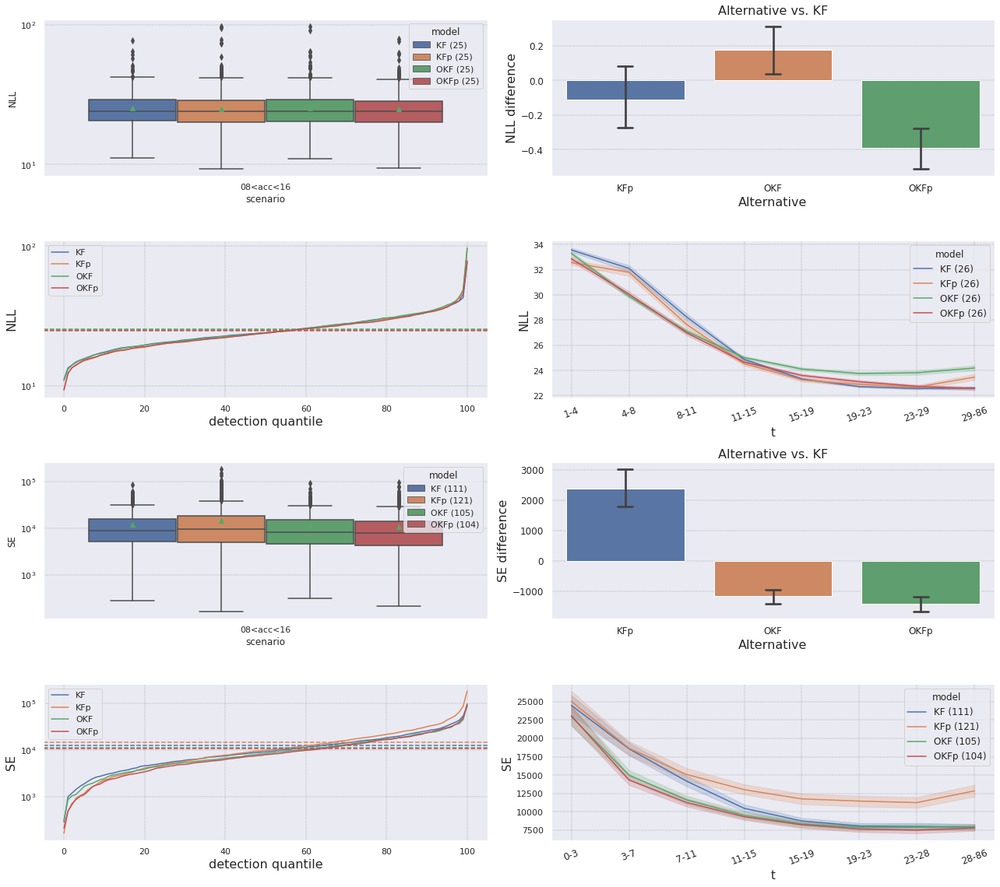

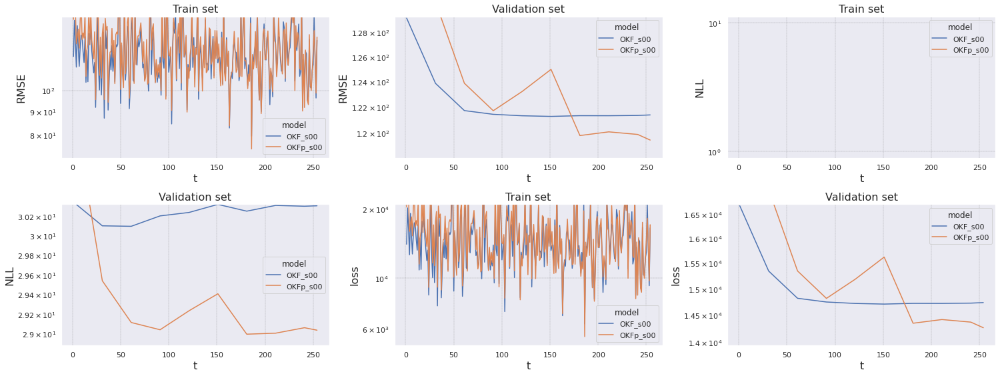

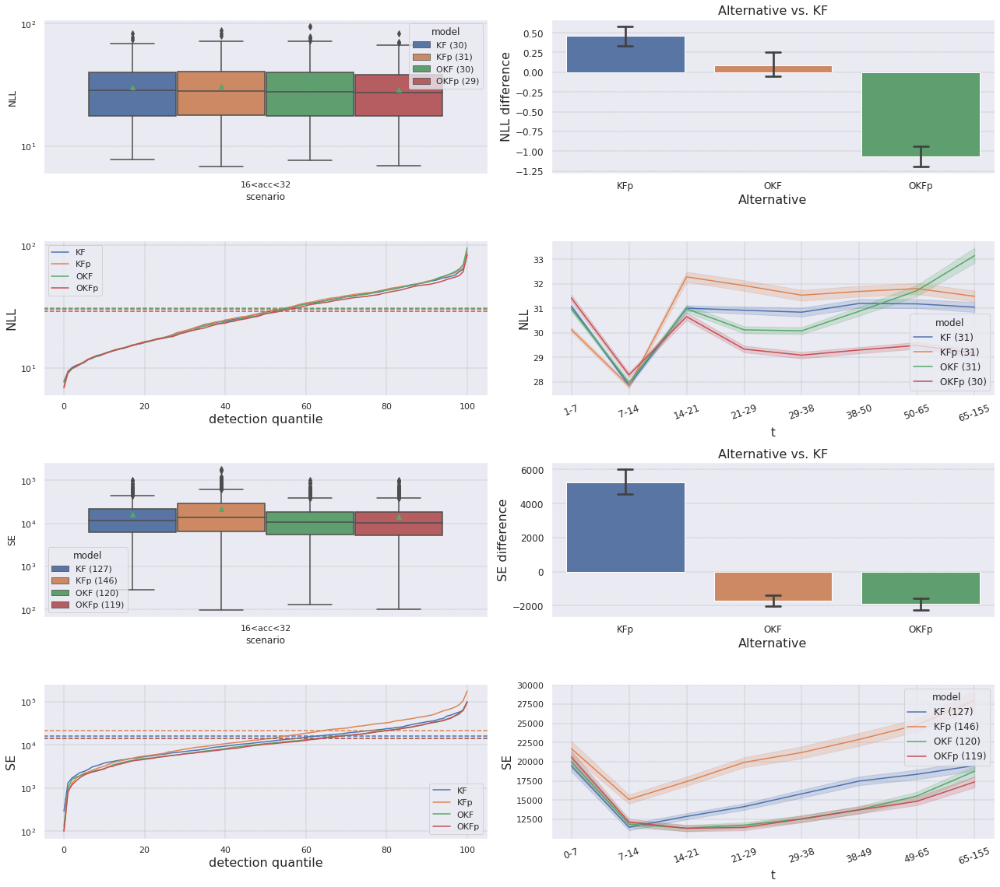

In [51]:
rr = pd.DataFrame()
for n_train in (20, 30, 50, 100, 300, 1000, n):
    rr = pd.concat((rr, PLAB.multi_scenario_test(scs, margs, n_train=n_train, epochs=2, min_iters=150)))
# rr['scenario'] = [f'Free{sc[len("multiphase"):]:s}' for sc in rr.scenario]
rr_tar = PLAB.res_per_target(rr, ['model','scenario'])

CPU times: user 2min 27s, sys: 431 ms, total: 2min 28s
Wall time: 2min 27s


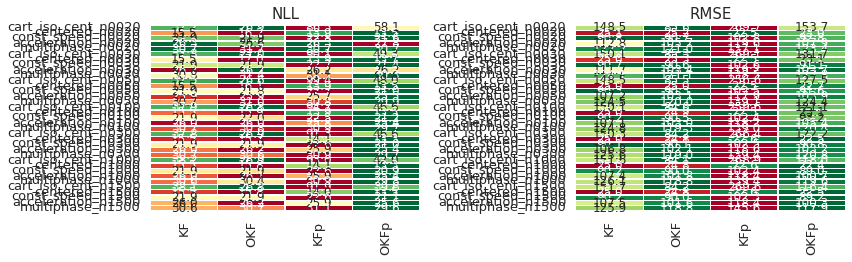

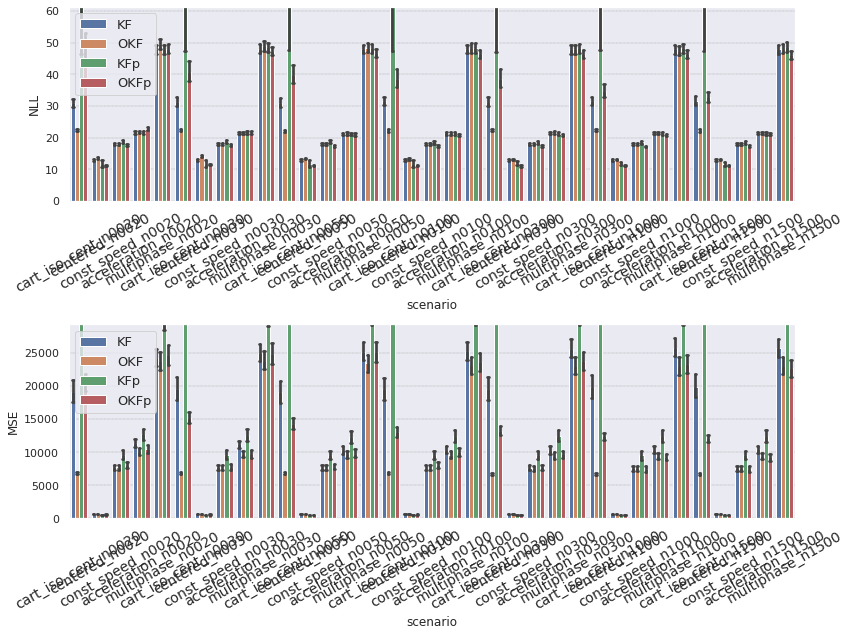

In [60]:
%time axs = PLAB.multi_scenario_analysis(rr, rr_tar, hetro_models=False)

In [53]:
r = pd.DataFrame()
for m in np.unique(rr.model):
    r = pd.concat((r, rr[rr.model==m].groupby('scenario').apply(lambda d: pd.DataFrame(dict(model=m, scenario=(d.scenario.values[0] if d.scenario.values[0]!='multiphase' else 'multiphase_n1500'), MSE=d.SE.mean()), index=[0]))))
r.reset_index(inplace=True, drop=True)
r.sort_values('scenario', inplace=True)
r

,model,scenario,MSE
0,KF,acceleration_n0020,13404.455899
35,KFp,acceleration_n0020,14935.143487
70,OKF,acceleration_n0020,11908.449610
105,OKFp,acceleration_n0020,12346.505205
36,KFp,acceleration_n0030,14842.594447
...,...,...,...
33,KF,multiphase_n1000,16195.265982
69,KFp,multiphase_n1500,21407.092719
34,KF,multiphase_n1500,16153.162726
104,OKF,multiphase_n1500,14451.727709


<ipython-input-54-330508a13d66>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=30);


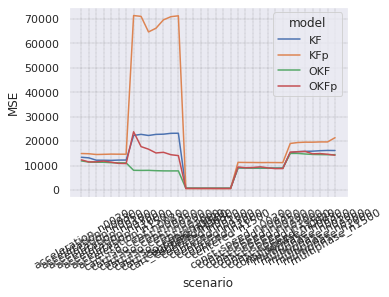

In [54]:
ax = utils.Axes(1,1)[0]
sns.lineplot(data=r, x='scenario', hue='model', y='MSE', ax=ax);
plt.draw()
ax.set_xticklabels(ax.get_xticklabels(), rotation=30);

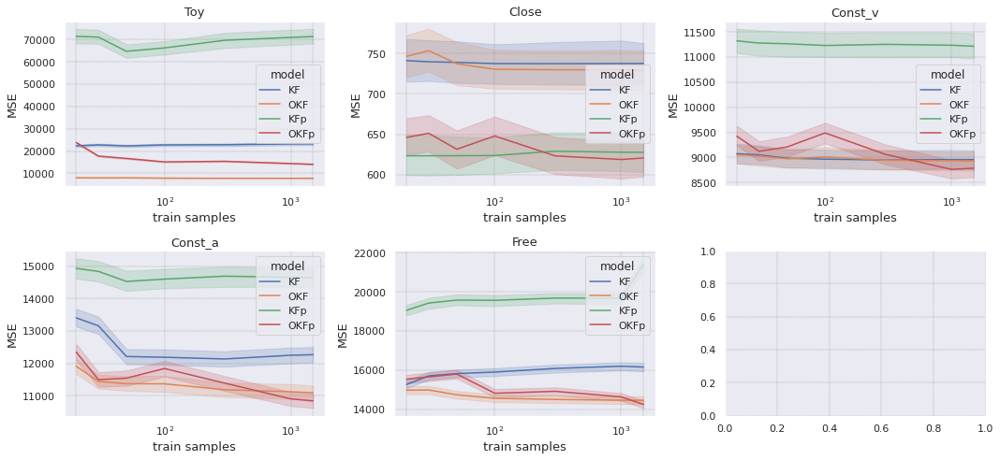

In [63]:
axs = utils.Axes(6,3)
for a, sc in enumerate(scs):
    rrr = rr[[s.startswith(sc) for s in rr.scenario]].copy()
    rrr['train_samples'] = [int(sc[-4:]) for sc in rrr.scenario]

    ax = axs[a]
    sns.lineplot(data=rrr[rrr.model!='KF_pol'], x='train_samples', hue='model', y='SE', ax=ax, ci=95);
    axs.labs(a, 'train samples', 'MSE', scenarios_labs[a])
    ax.set_xscale('log');
plt.tight_layout()
plt.savefig('outputs/train_size.png', bbox_inches='tight')

# Optimized $R$ vs. optimized $Q$

In the main benchmark (*multiphase* scenario), it seems that **both optimizations of $R$ and of $Q$ are valuable to the performance**. Optimization of $R$ seems to be more dominant in MSE improvement, and optimization of $Q$ in NLL.

These results were *not* verified widely over different scenarios and initial weights.

In [67]:
models_args = (
    dict(load=False, title='KF', no_acc=True),
    dict(load=False, title='ORKF', no_acc=True, const_R=False),
    dict(load=False, title='OQKF', no_acc=True, const_Q=False),
    dict(load=False, title='OKF', no_acc=True, const_Q=False, const_R=False),
)

model_names = [a['title'] for a in models_args]

gc.collect()

6161


multiphase
Waiting for trainings...
Waiting for processes...
Done.	(295 [s])
Best validation losses:
	KF: inf (KF_s00)
	ORKF: 122 (ORKF_s00)
	OQKF: 124 (OQKF_s00)
	OKF: 121 (OKF_s00)


/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:639: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs[a+0].set_yscale('log')
/home/ido/code/Using_KF_the_Right_Way/PredictionLab.py:642: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  axs[a+0].set_ylim((None,np.percentile(res[res.group=='train'][y], ylim_quant)))


4 models are split to 1 batches.
Running 20 threads...
Finished models-batch 1/1.	(30 [s])


/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])
/home/ido/code/Using_KF_the_Right_Way/utils.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=ticks[1])


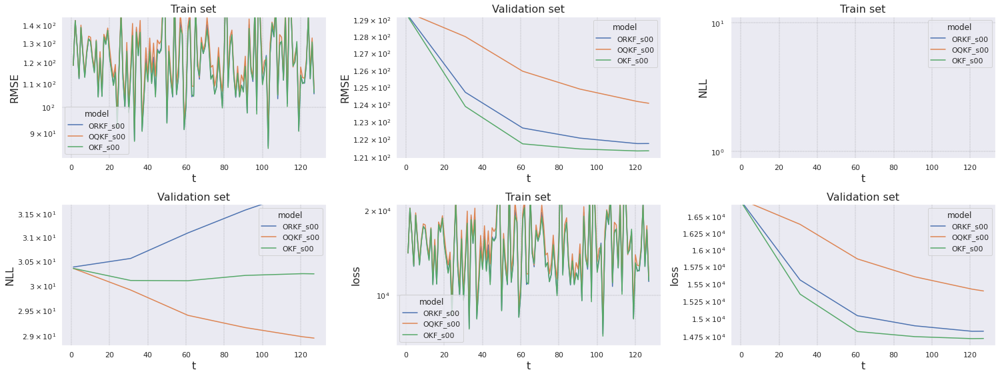

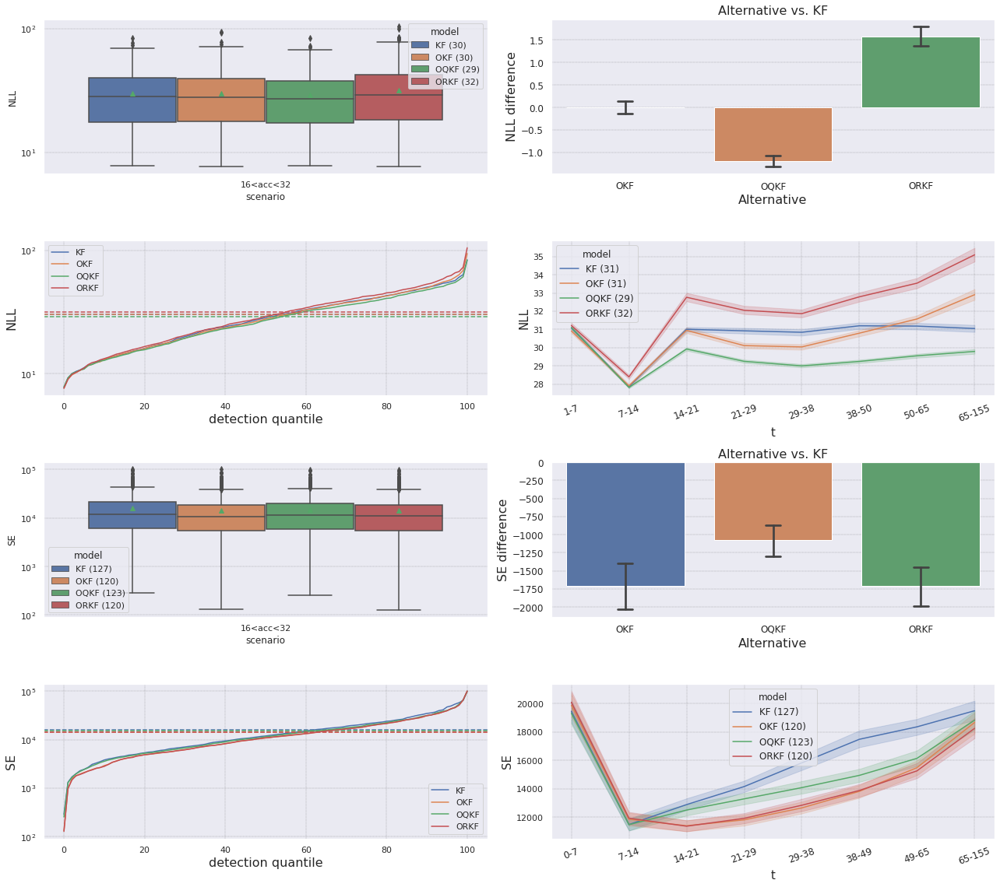

In [68]:
scenario = 'multiphase'
res = PLAB.multi_scenario_test([scenario], models_args)

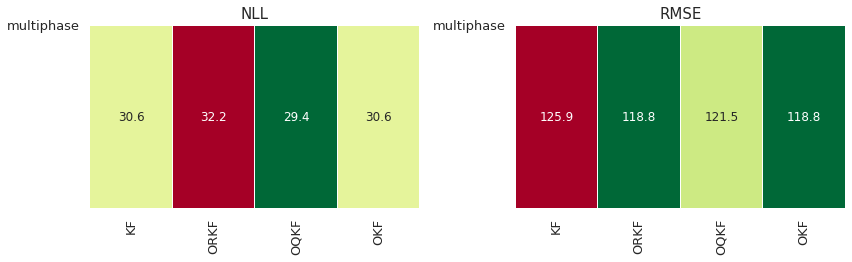

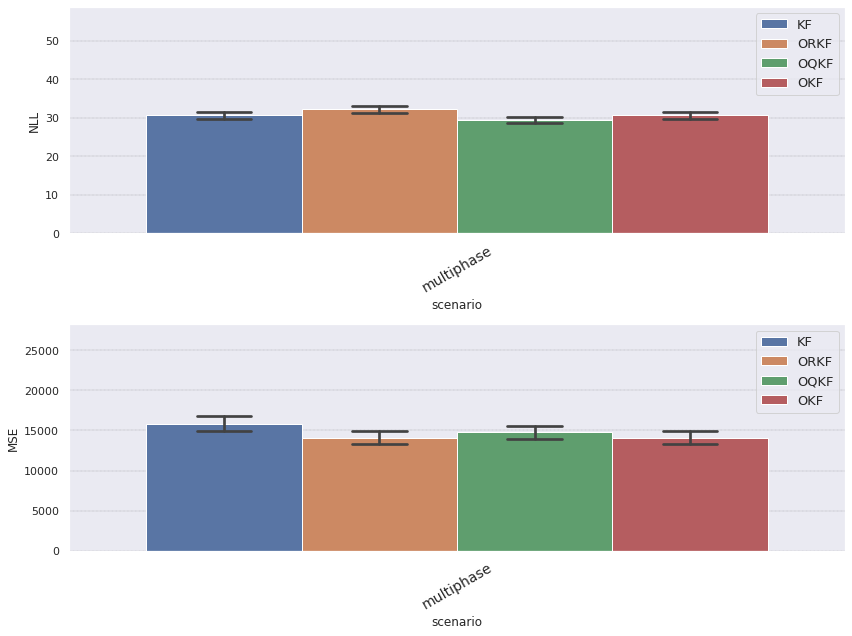

In [69]:
axs = PLAB.multi_scenario_analysis(res, scenarios=[scenario], models=('KF','ORKF','OQKF','OKF'), hetro_models=False);